## Generative Adversarial Network (GAN)

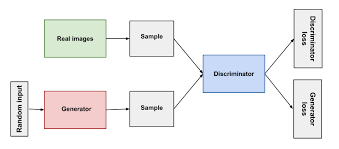

#### The basic idea underlying a GAN is that there are two models which train each other through a minimax game -- a generative model tries to create realistic data instances and a discriminative model classifies data as real or generated by the generative model. The generator is trained to fool the discriminator by making the generated data close to the original data distribution while the discriminator is trained to correctly differentiate between the generator's output and the original data. 



## Load Pytorch datasets

In [1]:
import torch
import torchvision
import matplotlib.pyplot as plt 
import tqdm
import numpy as np

In [2]:
def download_data(image_size, dataset_type):
    """Download MNIST or FashionMNIST dataset and create a data loader."""

    transformations = torchvision.transforms.Compose([
      torchvision.transforms.Resize(image_size),
      torchvision.transforms.ToTensor(),
      torchvision.transforms.Normalize(mean=(0.5), std=(0.5))
    ])

    if dataset_type == 'MNIST':
      # MNIST train set
      mnist_train = torchvision.datasets.MNIST(
        root="./dataset",
        train=True,
        download=True,
        transform=transformations
      )
      return mnist_train
    elif dataset_type == 'FashionMNIST':
      # FashionMNIST train set
      fashion_mnist_train = torchvision.datasets.FashionMNIST(
        root="./dataset",
        train=True,
        download=True,
        transform=transformations
      )
      return fashion_mnist_train
    return None

## MNIST

Dataset MNIST
    Number of datapoints: 60000
    Root location: ./dataset
    Split: Train
    StandardTransform
Transform: ToTensor()
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./dataset
    Split: Test
    StandardTransform
Transform: ToTensor()
['0 - zero', '1 - one', '2 - two', '3 - three', '4 - four', '5 - five', '6 - six', '7 - seven', '8 - eight', '9 - nine']
tensor([7, 2, 1,  ..., 4, 5, 6])
torch.Size([28, 28])


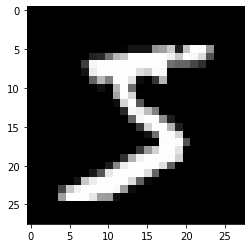

In [3]:
batch_size = 64
mnist_train, mnist_test = download_data()
print(mnist_train)
print(mnist_test)

print(mnist_train.classes)
print(mnist_test.targets)

# visualize first image
print(mnist_train[0][0][0].shape)
plt.imshow(mnist_train[0][0][0], cmap='Greys_r')

In [4]:
train_loader = torch.utils.data.DataLoader(
    mnist_train, batch_size=batch_size, drop_last=True, shuffle=True
)
test_loader = torch.utils.data.DataLoader(
    mnist_test, batch_size=batch_size, drop_last=True, shuffle=True
)

for images, labels in train_loader:
    print(images.shape, labels.shape)
    break
    
# num minibatches 
print(len(train_loader))

torch.Size([64, 1, 28, 28]) torch.Size([64])
937


In [5]:
class Generator(torch.nn.Module):
    def __init__(self, image_shape, hidden_dim):
        super().__init__()
        self.hidden0 = torch.nn.Sequential(torch.nn.Linear(image_shape, hidden_dim), torch.nn.LeakyReLU(0.2))
        self.hidden1 = torch.nn.Sequential(torch.nn.Linear(hidden_dim, hidden_dim * 2), torch.nn.LeakyReLU(0.2))
        self.hidden2 = torch.nn.Sequential(torch.nn.Linear(hidden_dim * 2, hidden_dim * 4), torch.nn.LeakyReLU(0.2))
        self.tanh = torch.nn.Tanh()
        self.out = torch.nn.Linear(hidden_dim * 4, image_shape)
        
    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        return self.tanh(self.out(x))

In [6]:
class Discriminator(torch.nn.Module):
    def __init__(self, image_shape, hidden_dim):
        super().__init__()
        self.hidden0 = torch.nn.Sequential(torch.nn.Linear(image_shape, hidden_dim * 4), torch.nn.LeakyReLU(0.2), torch.nn.Dropout(0.3))
        self.hidden1 = torch.nn.Sequential(torch.nn.Linear(hidden_dim * 4, hidden_dim * 2), torch.nn.LeakyReLU(0.2), torch.nn.Dropout(0.3))
        self.hidden2 = torch.nn.Sequential(torch.nn.Linear(hidden_dim * 2, hidden_dim), torch.nn.LeakyReLU(0.2), torch.nn.Dropout(0.3))
        self.out = torch.nn.Sequential(torch.nn.Linear(hidden_dim, 1), torch.nn.Sigmoid())
        
    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        return self.out(x)

In [7]:
image_shape, hidden_dim = 28 * 28, 128

In [8]:
generator = Generator(image_shape, hidden_dim)
discriminator = Discriminator(image_shape, hidden_dim)

d_optim, g_optim = torch.optim.Adam(
    discriminator.parameters(), lr=2e-4, betas=(0.0, 0.9)
), torch.optim.Adam(
    generator.parameters(), lr=2e-4, betas=(0.0, 0.9)
)
criterion = torch.nn.BCELoss()

In [9]:
def generate_fake_samples(generator):
    latents = torch.randn(batch_size, image_shape)
    # print(latents.shape)
    fake_samples = generator(latents)
    return fake_samples

In [17]:
def display_fake_samples(generated_images, epoch, cnt):
    fig = plt.figure(figsize=(8, 8))
    columns, rows = 8, 8
    for i in range(1, columns*rows +1):
        # img = np.random.randint(10, size=(10, 10))
        img = torch.unsqueeze(generated_images[i-1], dim=0).view((28, 28))
        fig.add_subplot(rows, columns, i)
        plt.imshow(img, cmap='Greys_r')
        plt.savefig("output/mnist_" + str(epoch) + "_" + str(cnt) + ".png")
    plt.show()

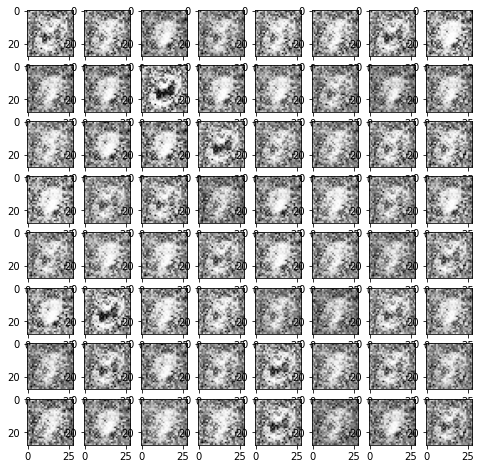

Epoch:  0
Discriminator Real Loss:  tensor(0.7346, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6636, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.7425, grad_fn=<BinaryCrossEntropyBackward0>)


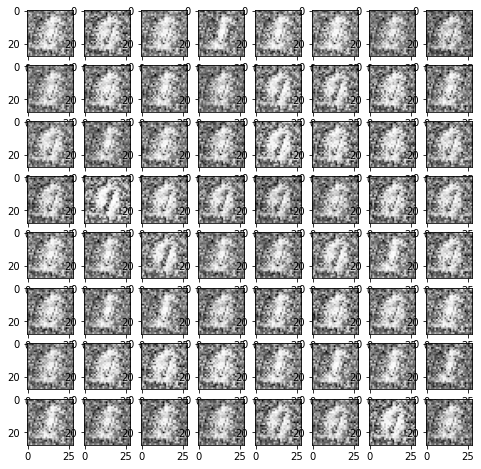

Epoch:  0
Discriminator Real Loss:  tensor(0.7307, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6567, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.7493, grad_fn=<BinaryCrossEntropyBackward0>)


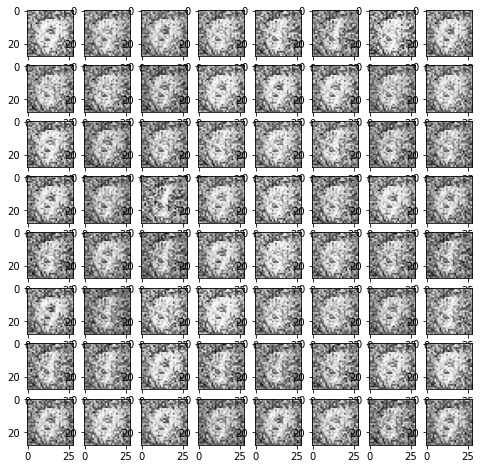

Epoch:  0
Discriminator Real Loss:  tensor(0.6788, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.7003, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.7460, grad_fn=<BinaryCrossEntropyBackward0>)


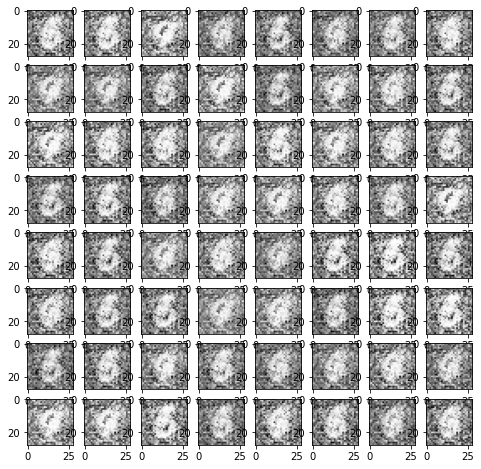

Epoch:  0
Discriminator Real Loss:  tensor(0.6906, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6695, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.7443, grad_fn=<BinaryCrossEntropyBackward0>)


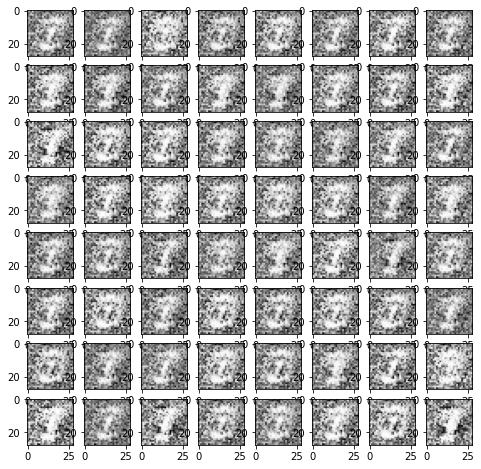

Epoch:  1
Discriminator Real Loss:  tensor(0.6038, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(1.0985, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.7713, grad_fn=<BinaryCrossEntropyBackward0>)


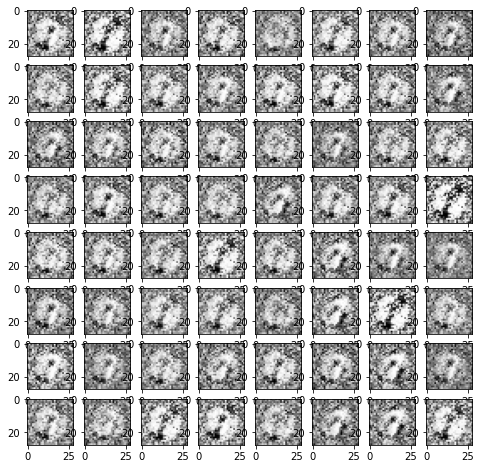

Epoch:  1
Discriminator Real Loss:  tensor(0.6695, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.7300, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.6897, grad_fn=<BinaryCrossEntropyBackward0>)


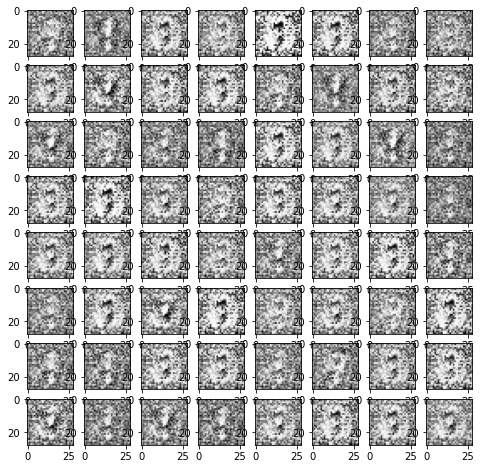

Epoch:  1
Discriminator Real Loss:  tensor(0.6500, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.7224, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.6949, grad_fn=<BinaryCrossEntropyBackward0>)


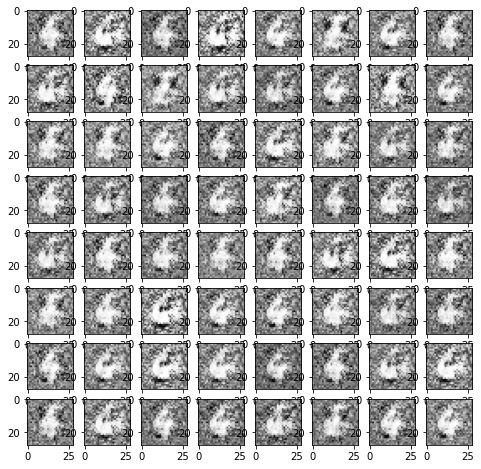

Epoch:  1
Discriminator Real Loss:  tensor(0.7057, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6996, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.7397, grad_fn=<BinaryCrossEntropyBackward0>)


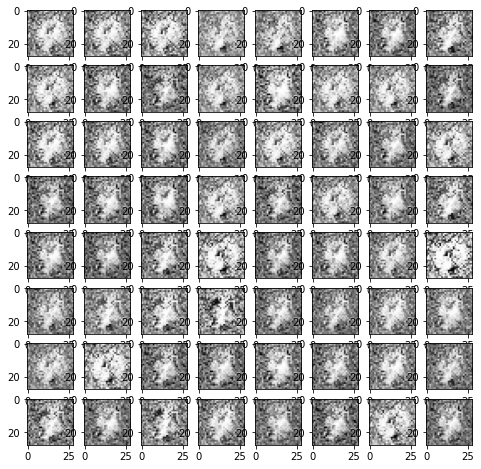

Epoch:  2
Discriminator Real Loss:  tensor(0.7369, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6520, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.7684, grad_fn=<BinaryCrossEntropyBackward0>)


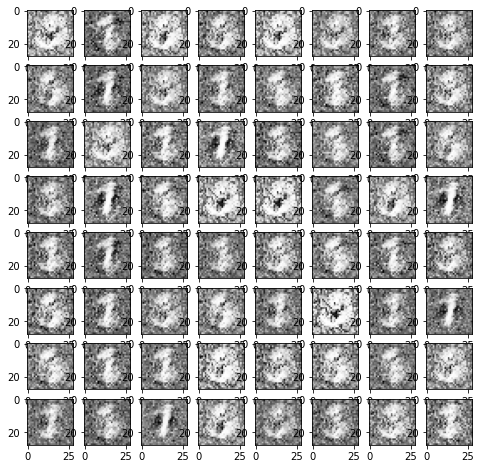

Epoch:  2
Discriminator Real Loss:  tensor(0.7259, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6546, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.7575, grad_fn=<BinaryCrossEntropyBackward0>)


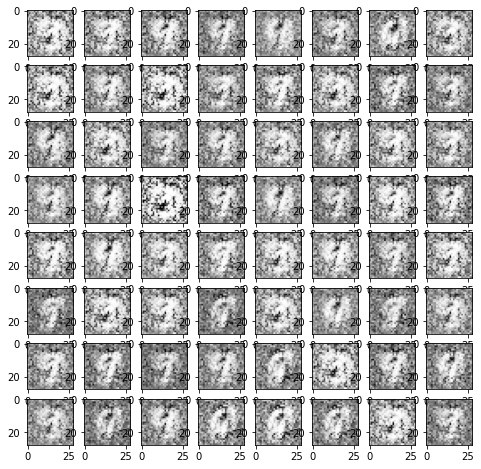

Epoch:  2
Discriminator Real Loss:  tensor(0.7102, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6694, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.7282, grad_fn=<BinaryCrossEntropyBackward0>)


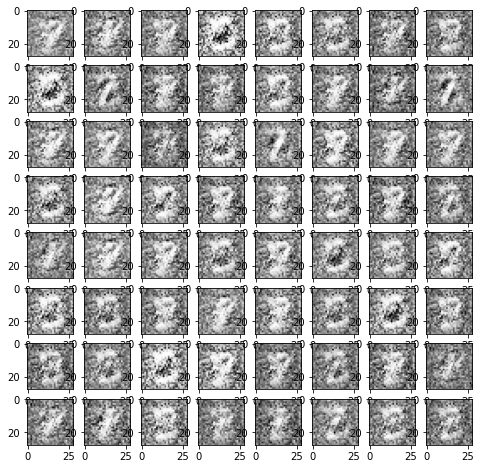

Epoch:  2
Discriminator Real Loss:  tensor(0.7083, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6973, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.7035, grad_fn=<BinaryCrossEntropyBackward0>)


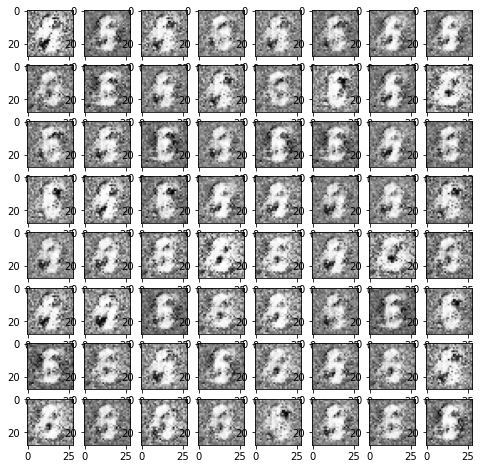

Epoch:  3
Discriminator Real Loss:  tensor(0.7802, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.5745, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.8387, grad_fn=<BinaryCrossEntropyBackward0>)


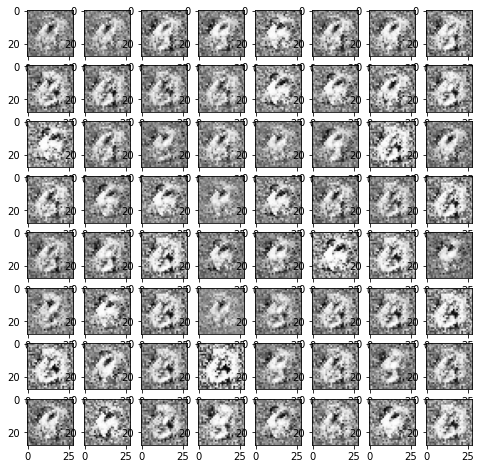

Epoch:  3
Discriminator Real Loss:  tensor(0.7114, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6481, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.8023, grad_fn=<BinaryCrossEntropyBackward0>)


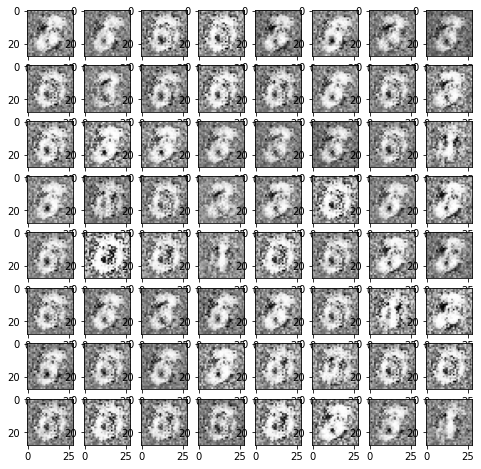

Epoch:  3
Discriminator Real Loss:  tensor(0.4499, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6836, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.8451, grad_fn=<BinaryCrossEntropyBackward0>)


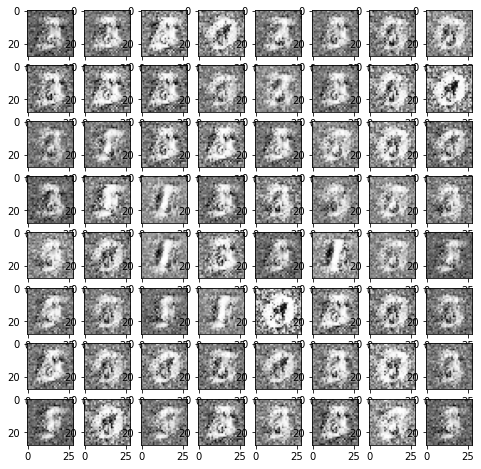

Epoch:  3
Discriminator Real Loss:  tensor(0.7334, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.5915, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.8497, grad_fn=<BinaryCrossEntropyBackward0>)


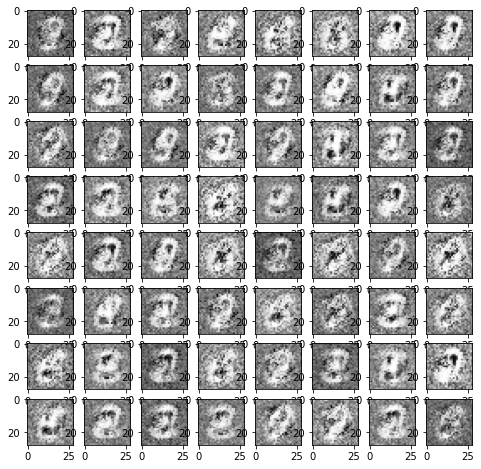

Epoch:  4
Discriminator Real Loss:  tensor(0.6219, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.5940, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.0092, grad_fn=<BinaryCrossEntropyBackward0>)


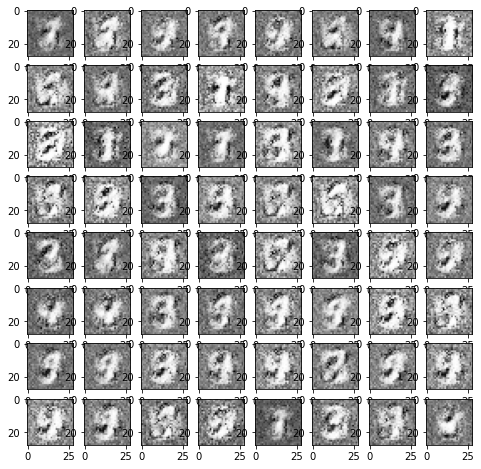

Epoch:  4
Discriminator Real Loss:  tensor(0.7123, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4969, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.9837, grad_fn=<BinaryCrossEntropyBackward0>)


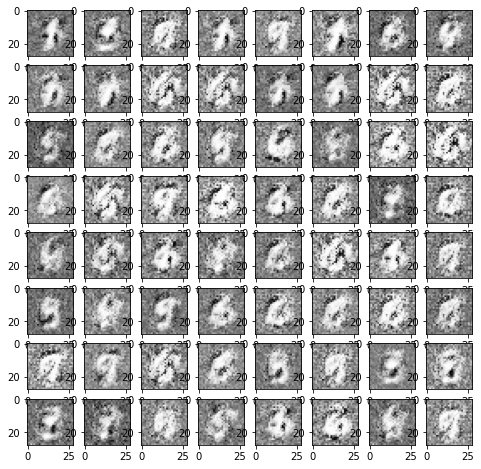

Epoch:  4
Discriminator Real Loss:  tensor(0.6658, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6492, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.1260, grad_fn=<BinaryCrossEntropyBackward0>)


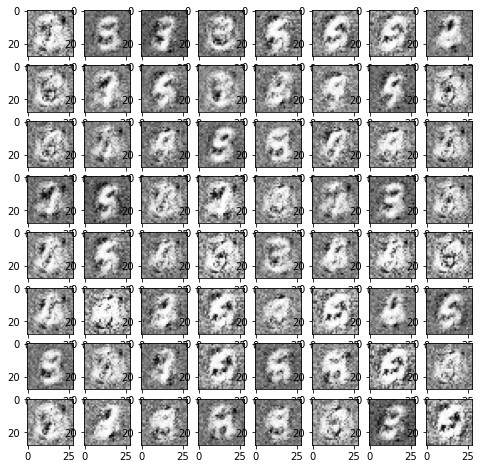

Epoch:  4
Discriminator Real Loss:  tensor(0.6340, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.5620, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.0894, grad_fn=<BinaryCrossEntropyBackward0>)


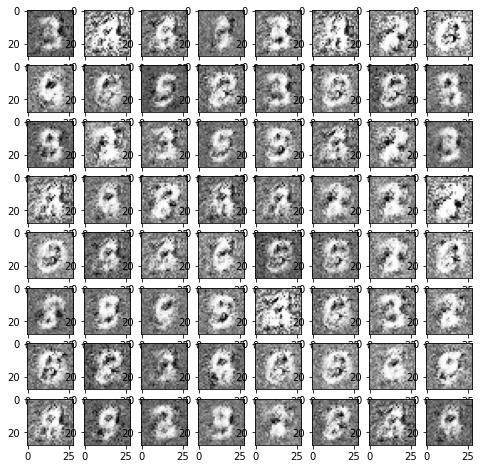

Epoch:  5
Discriminator Real Loss:  tensor(0.4912, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.7969, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.3596, grad_fn=<BinaryCrossEntropyBackward0>)


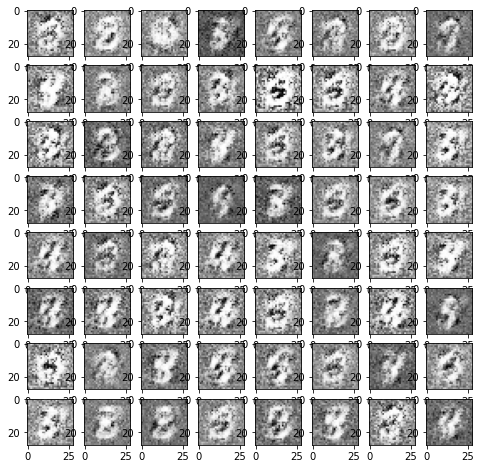

Epoch:  5
Discriminator Real Loss:  tensor(0.3858, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6944, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.5985, grad_fn=<BinaryCrossEntropyBackward0>)


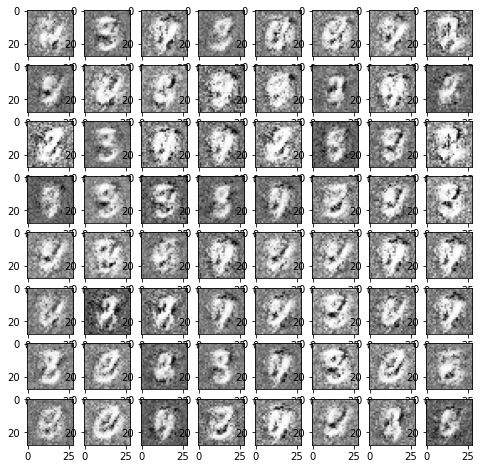

Epoch:  5
Discriminator Real Loss:  tensor(0.5531, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4675, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.3057, grad_fn=<BinaryCrossEntropyBackward0>)


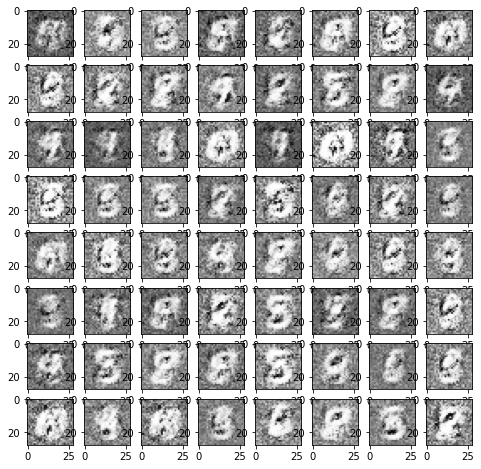

Epoch:  5
Discriminator Real Loss:  tensor(0.5170, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.7112, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.4743, grad_fn=<BinaryCrossEntropyBackward0>)


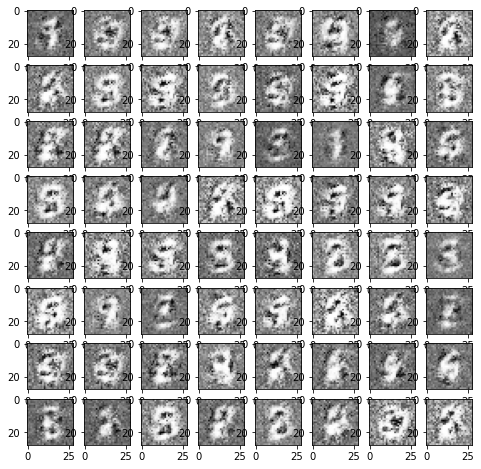

Epoch:  6
Discriminator Real Loss:  tensor(0.4691, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6282, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.5125, grad_fn=<BinaryCrossEntropyBackward0>)


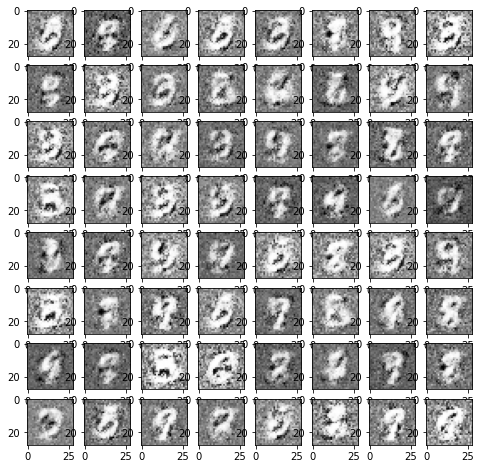

Epoch:  6
Discriminator Real Loss:  tensor(0.5097, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4272, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.3906, grad_fn=<BinaryCrossEntropyBackward0>)


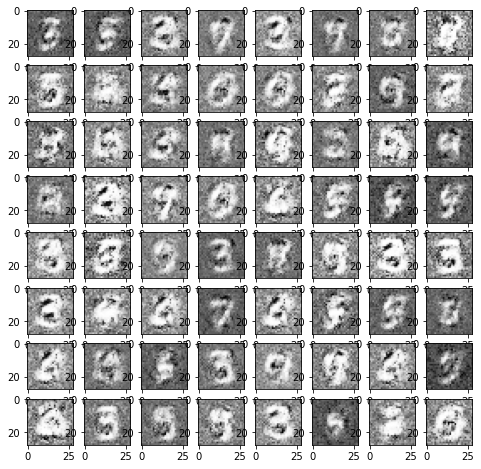

Epoch:  6
Discriminator Real Loss:  tensor(0.4444, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3966, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.3710, grad_fn=<BinaryCrossEntropyBackward0>)


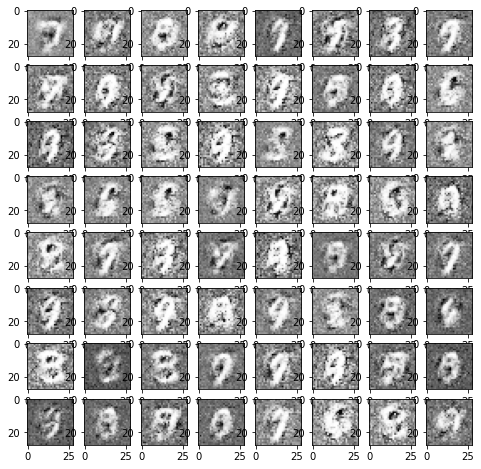

Epoch:  6
Discriminator Real Loss:  tensor(0.5367, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4350, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.3872, grad_fn=<BinaryCrossEntropyBackward0>)


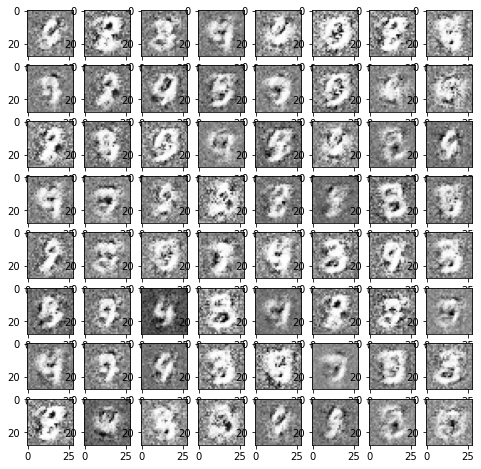

Epoch:  7
Discriminator Real Loss:  tensor(0.3292, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6867, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.9703, grad_fn=<BinaryCrossEntropyBackward0>)


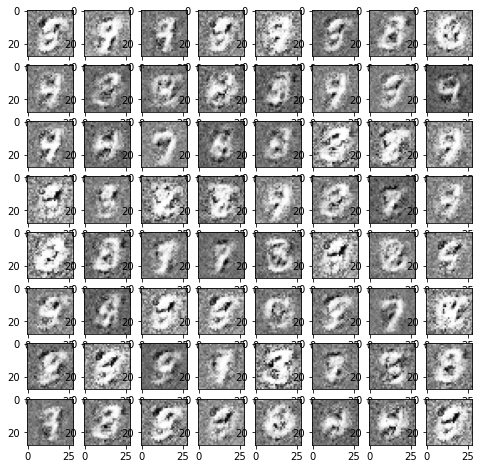

Epoch:  7
Discriminator Real Loss:  tensor(0.6143, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3918, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.4508, grad_fn=<BinaryCrossEntropyBackward0>)


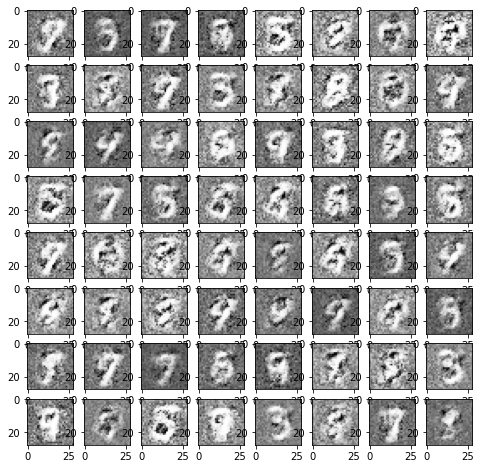

Epoch:  7
Discriminator Real Loss:  tensor(0.4639, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4633, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.7699, grad_fn=<BinaryCrossEntropyBackward0>)


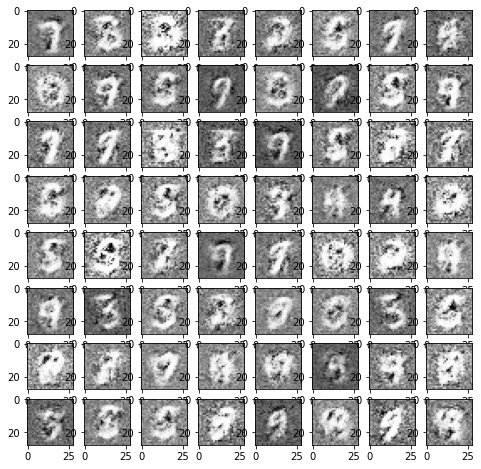

Epoch:  7
Discriminator Real Loss:  tensor(0.5709, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4317, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.5420, grad_fn=<BinaryCrossEntropyBackward0>)


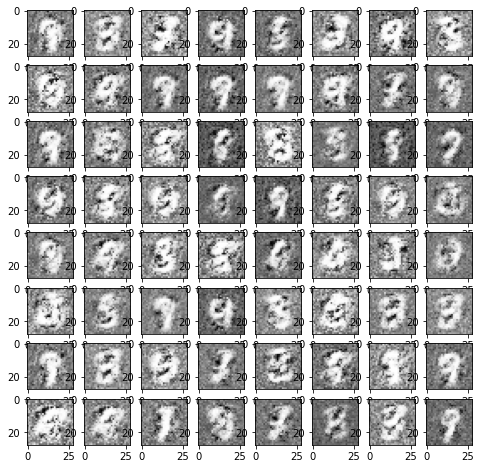

Epoch:  8
Discriminator Real Loss:  tensor(0.3830, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.7484, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.2120, grad_fn=<BinaryCrossEntropyBackward0>)


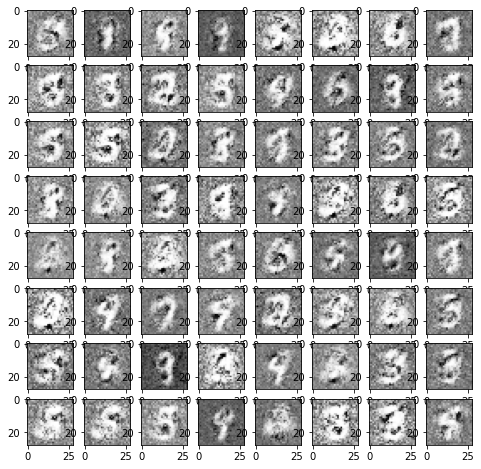

Epoch:  8
Discriminator Real Loss:  tensor(0.5533, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3197, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.5819, grad_fn=<BinaryCrossEntropyBackward0>)


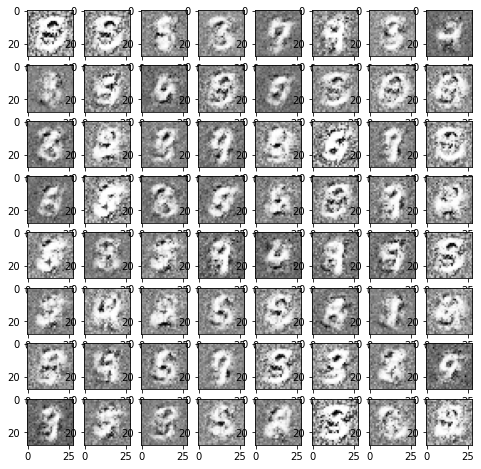

Epoch:  8
Discriminator Real Loss:  tensor(0.3496, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3921, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.8117, grad_fn=<BinaryCrossEntropyBackward0>)


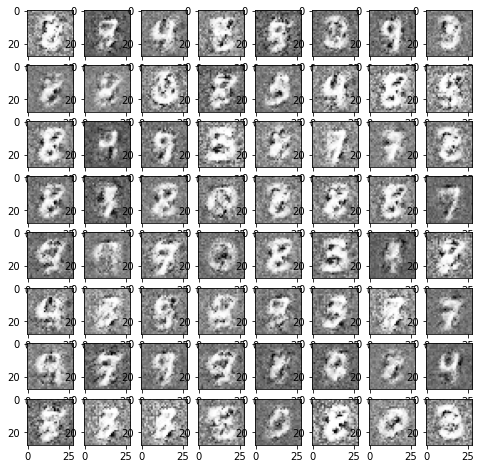

Epoch:  8
Discriminator Real Loss:  tensor(0.4300, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3351, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.6328, grad_fn=<BinaryCrossEntropyBackward0>)


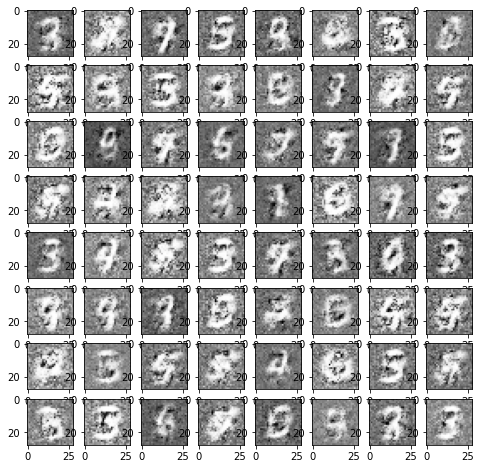

Epoch:  9
Discriminator Real Loss:  tensor(0.6182, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3452, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.7985, grad_fn=<BinaryCrossEntropyBackward0>)


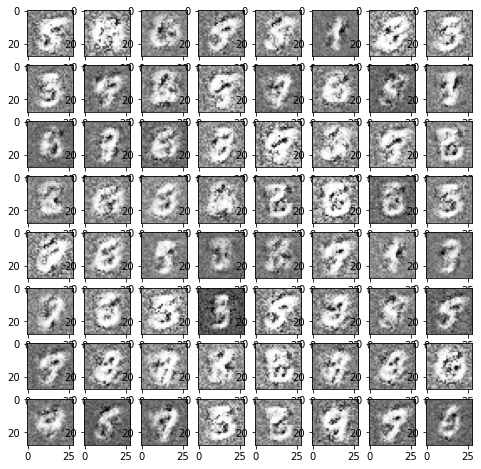

Epoch:  9
Discriminator Real Loss:  tensor(0.3379, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.5636, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.4297, grad_fn=<BinaryCrossEntropyBackward0>)


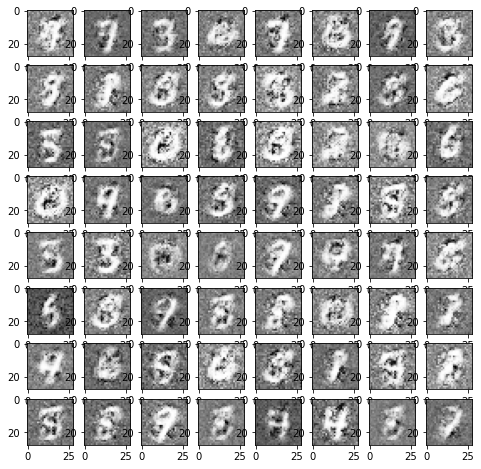

Epoch:  9
Discriminator Real Loss:  tensor(0.6561, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.5253, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.6991, grad_fn=<BinaryCrossEntropyBackward0>)


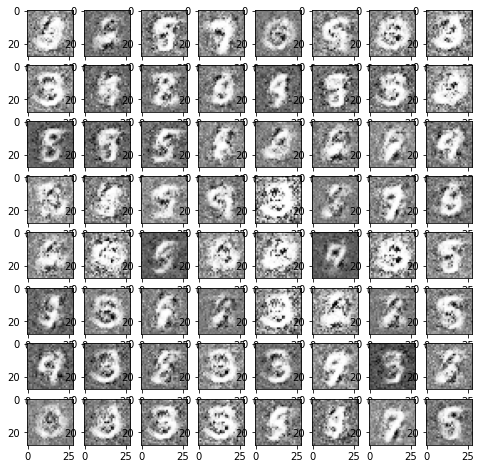

Epoch:  9
Discriminator Real Loss:  tensor(0.5202, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3732, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.6527, grad_fn=<BinaryCrossEntropyBackward0>)


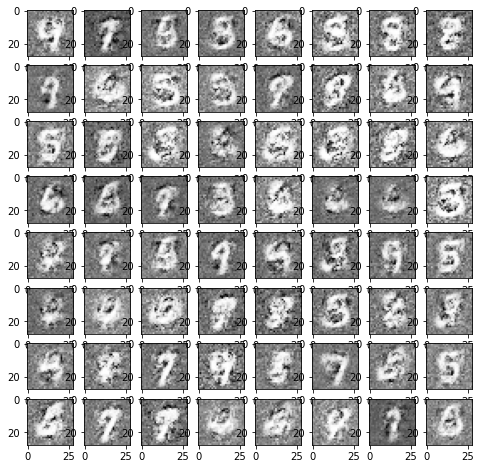

Epoch:  10
Discriminator Real Loss:  tensor(0.3988, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4297, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.8705, grad_fn=<BinaryCrossEntropyBackward0>)


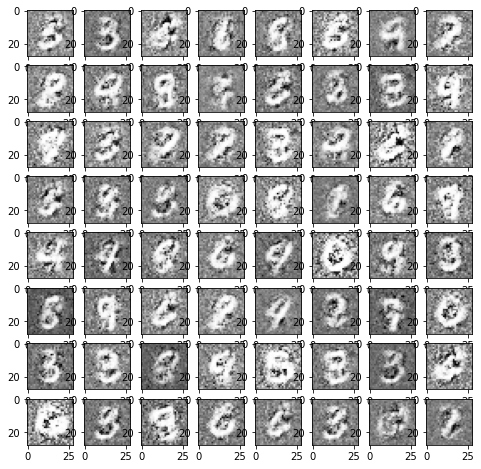

Epoch:  10
Discriminator Real Loss:  tensor(0.5079, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3151, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.7194, grad_fn=<BinaryCrossEntropyBackward0>)


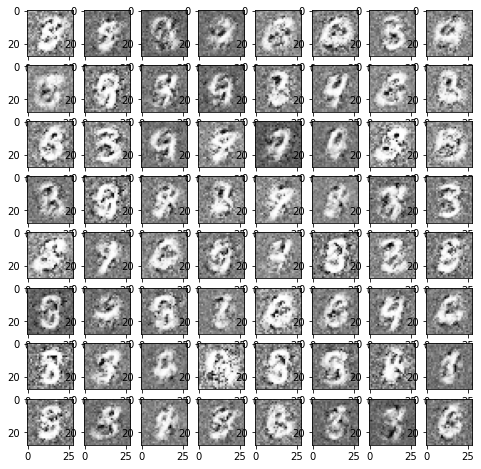

Epoch:  10
Discriminator Real Loss:  tensor(0.4925, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2683, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.6291, grad_fn=<BinaryCrossEntropyBackward0>)


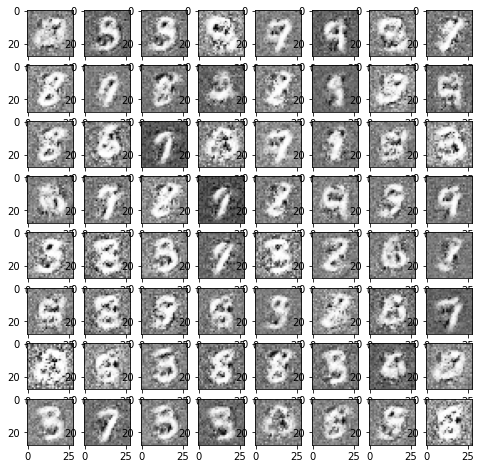

Epoch:  10
Discriminator Real Loss:  tensor(0.1985, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.7522, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.7071, grad_fn=<BinaryCrossEntropyBackward0>)


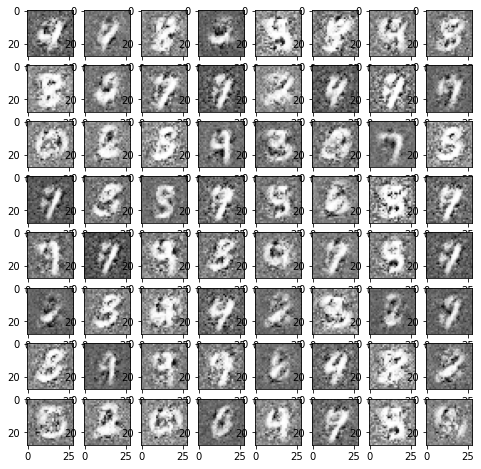

Epoch:  11
Discriminator Real Loss:  tensor(0.3652, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.7112, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.6154, grad_fn=<BinaryCrossEntropyBackward0>)


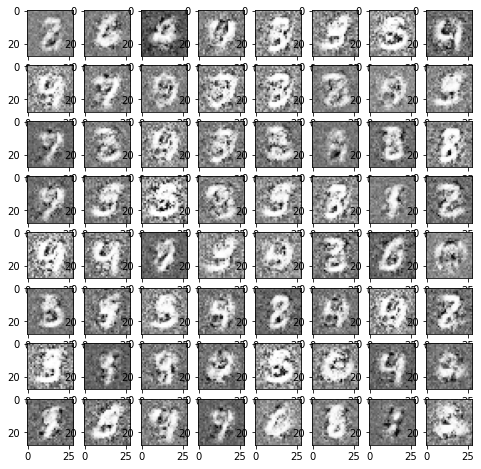

Epoch:  11
Discriminator Real Loss:  tensor(0.4511, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2647, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.1154, grad_fn=<BinaryCrossEntropyBackward0>)


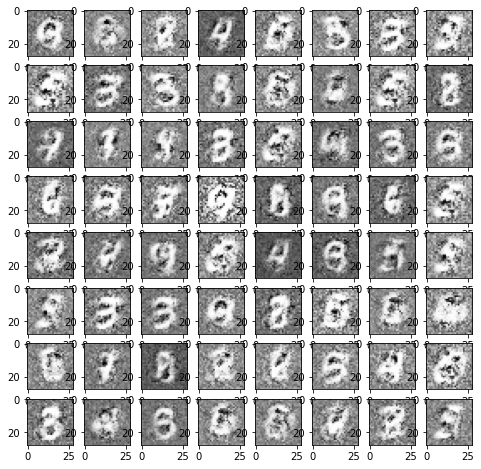

Epoch:  11
Discriminator Real Loss:  tensor(0.1678, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4074, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.6477, grad_fn=<BinaryCrossEntropyBackward0>)


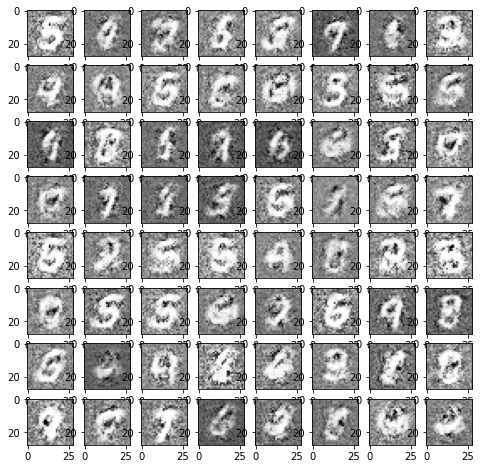

Epoch:  11
Discriminator Real Loss:  tensor(0.2243, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3567, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.0148, grad_fn=<BinaryCrossEntropyBackward0>)


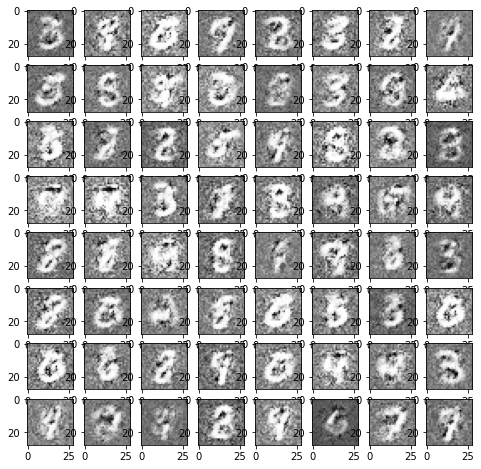

Epoch:  12
Discriminator Real Loss:  tensor(0.6654, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1154, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.6875, grad_fn=<BinaryCrossEntropyBackward0>)


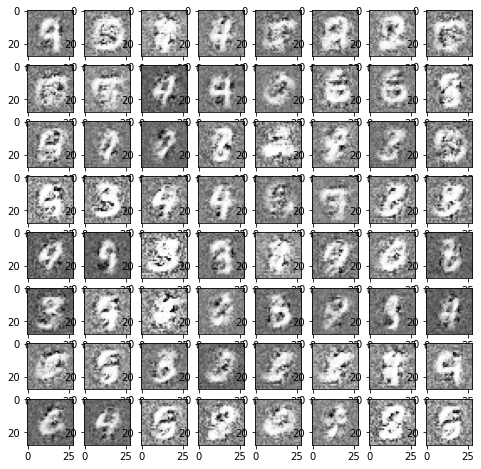

Epoch:  12
Discriminator Real Loss:  tensor(0.2751, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4435, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.0035, grad_fn=<BinaryCrossEntropyBackward0>)


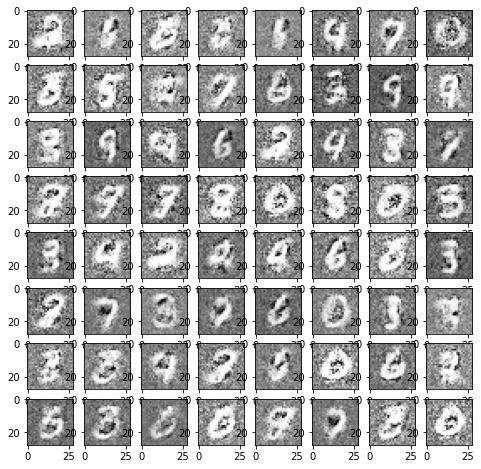

Epoch:  12
Discriminator Real Loss:  tensor(0.1674, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4653, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.4543, grad_fn=<BinaryCrossEntropyBackward0>)


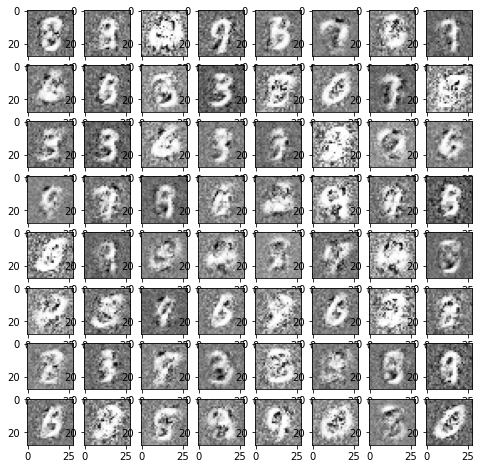

Epoch:  12
Discriminator Real Loss:  tensor(0.2230, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2869, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.6523, grad_fn=<BinaryCrossEntropyBackward0>)


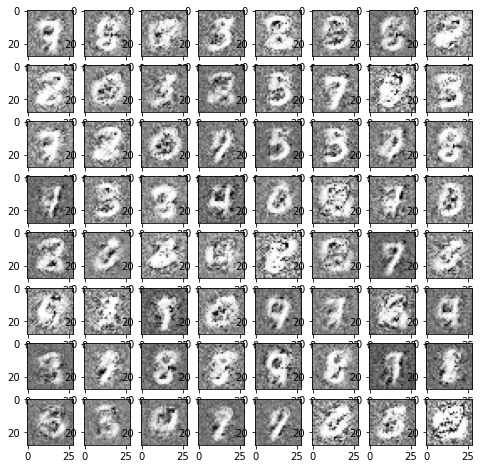

Epoch:  13
Discriminator Real Loss:  tensor(0.5150, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2030, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.7582, grad_fn=<BinaryCrossEntropyBackward0>)


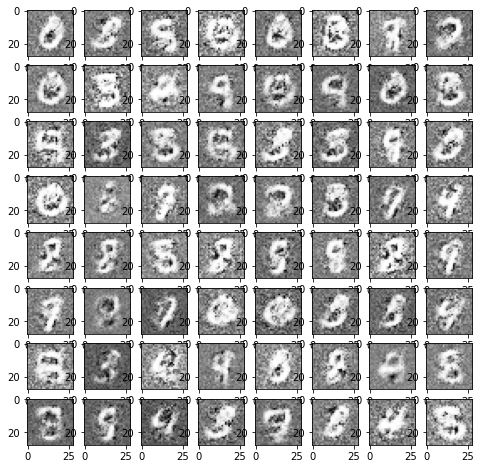

Epoch:  13
Discriminator Real Loss:  tensor(0.2685, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3703, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.4557, grad_fn=<BinaryCrossEntropyBackward0>)


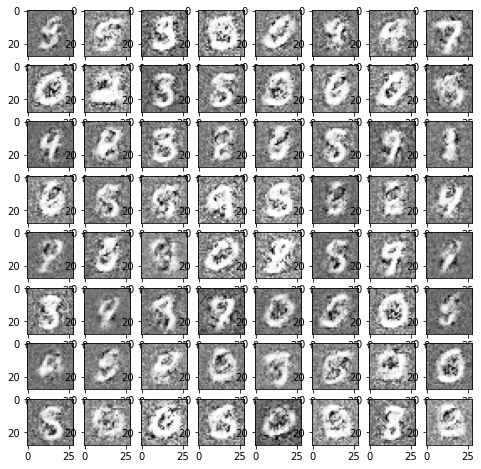

Epoch:  13
Discriminator Real Loss:  tensor(0.2606, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3297, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.5228, grad_fn=<BinaryCrossEntropyBackward0>)


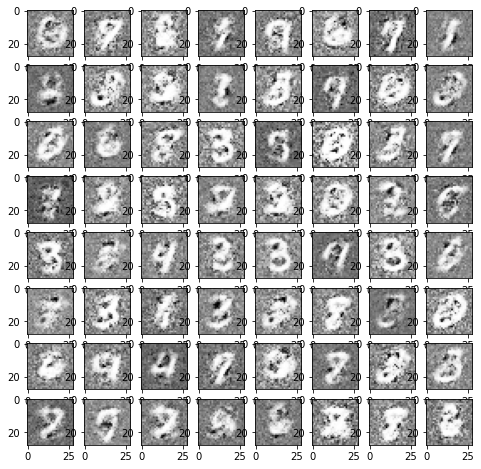

Epoch:  13
Discriminator Real Loss:  tensor(0.4200, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2953, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.3983, grad_fn=<BinaryCrossEntropyBackward0>)


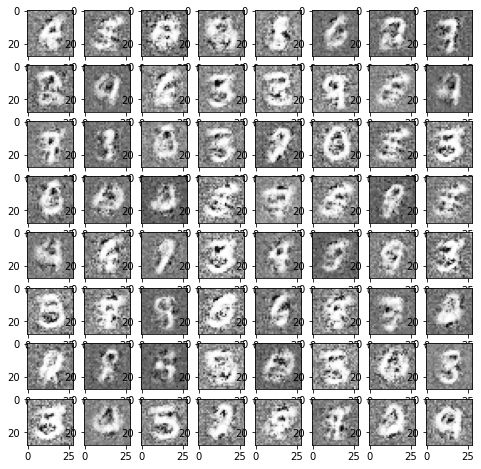

Epoch:  14
Discriminator Real Loss:  tensor(0.5549, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1206, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.4586, grad_fn=<BinaryCrossEntropyBackward0>)


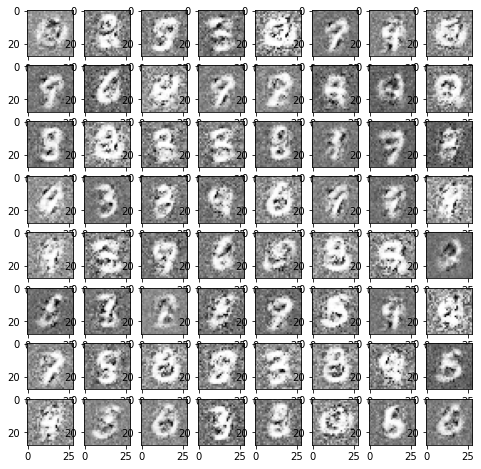

Epoch:  14
Discriminator Real Loss:  tensor(0.2778, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2515, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.9348, grad_fn=<BinaryCrossEntropyBackward0>)


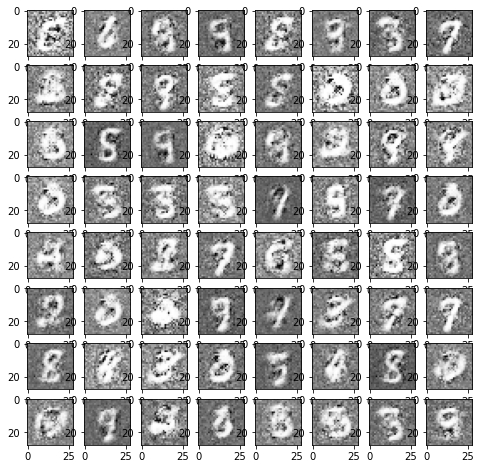

Epoch:  14
Discriminator Real Loss:  tensor(0.5843, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2184, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.9766, grad_fn=<BinaryCrossEntropyBackward0>)


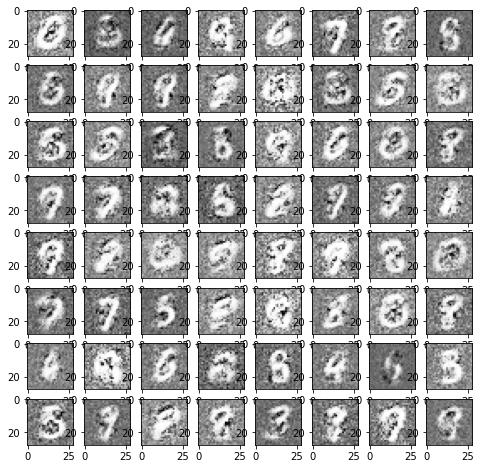

Epoch:  14
Discriminator Real Loss:  tensor(0.3502, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2532, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.8409, grad_fn=<BinaryCrossEntropyBackward0>)


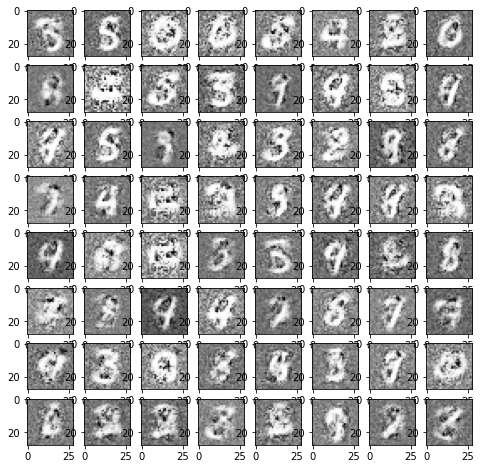

Epoch:  15
Discriminator Real Loss:  tensor(0.2896, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3513, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.0105, grad_fn=<BinaryCrossEntropyBackward0>)


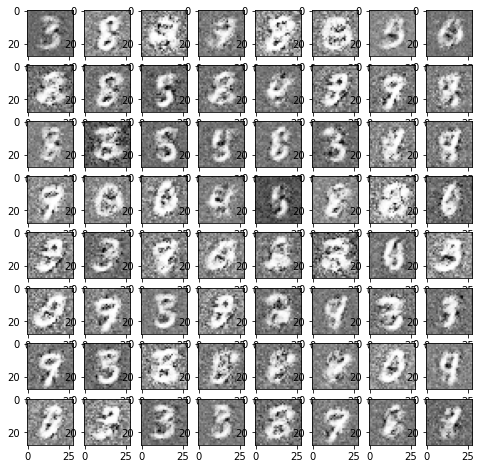

Epoch:  15
Discriminator Real Loss:  tensor(0.2420, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4792, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.4352, grad_fn=<BinaryCrossEntropyBackward0>)


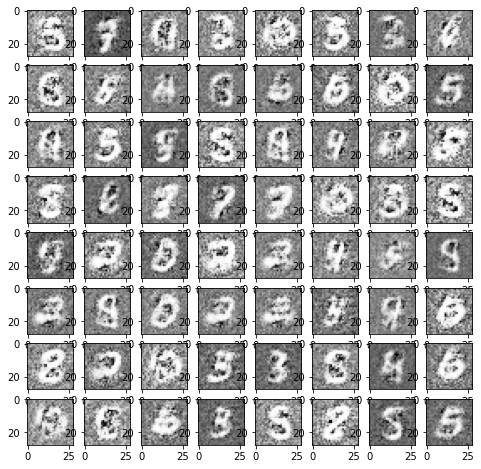

Epoch:  15
Discriminator Real Loss:  tensor(0.3487, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2504, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.0109, grad_fn=<BinaryCrossEntropyBackward0>)


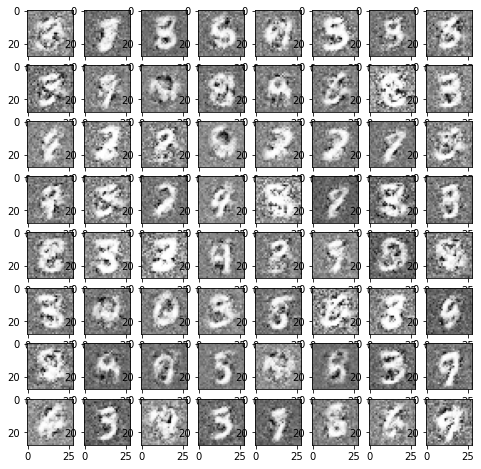

Epoch:  15
Discriminator Real Loss:  tensor(0.2114, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2558, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.6327, grad_fn=<BinaryCrossEntropyBackward0>)


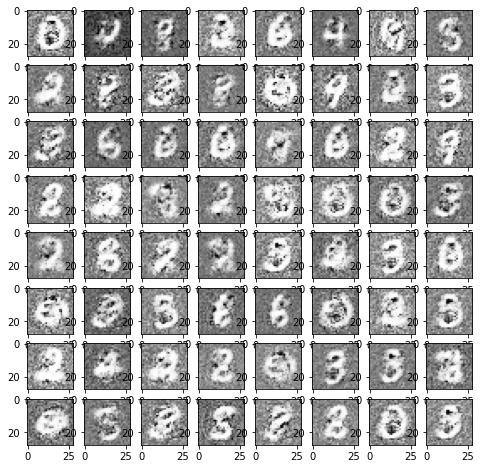

Epoch:  16
Discriminator Real Loss:  tensor(0.3163, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2961, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.8996, grad_fn=<BinaryCrossEntropyBackward0>)


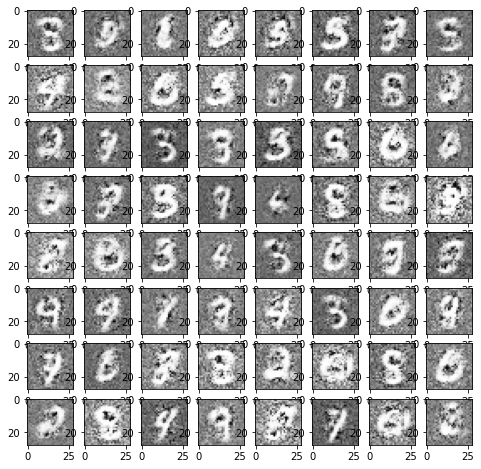

Epoch:  16
Discriminator Real Loss:  tensor(0.3080, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2641, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.7927, grad_fn=<BinaryCrossEntropyBackward0>)


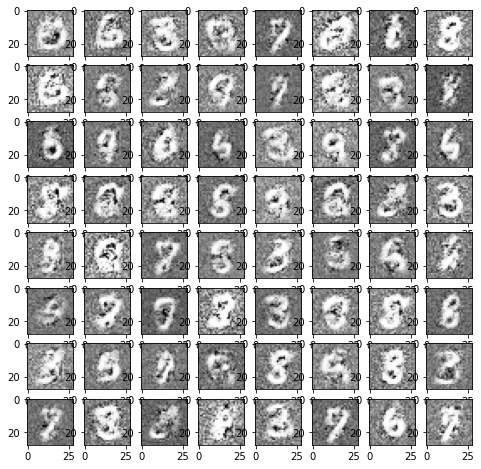

Epoch:  16
Discriminator Real Loss:  tensor(0.2651, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1676, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.8337, grad_fn=<BinaryCrossEntropyBackward0>)


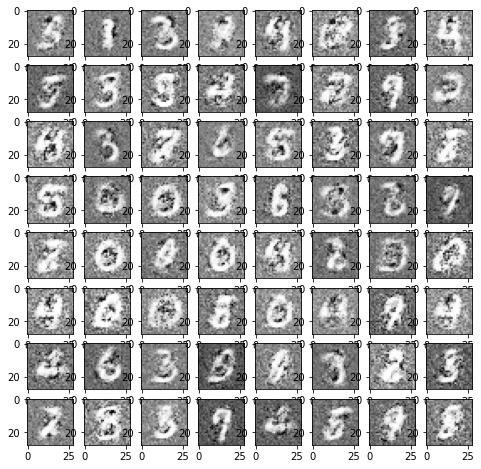

Epoch:  16
Discriminator Real Loss:  tensor(0.4582, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1666, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.2559, grad_fn=<BinaryCrossEntropyBackward0>)


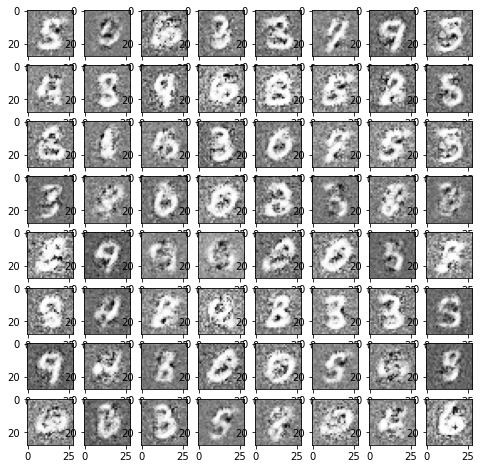

Epoch:  17
Discriminator Real Loss:  tensor(0.2911, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3528, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.4409, grad_fn=<BinaryCrossEntropyBackward0>)


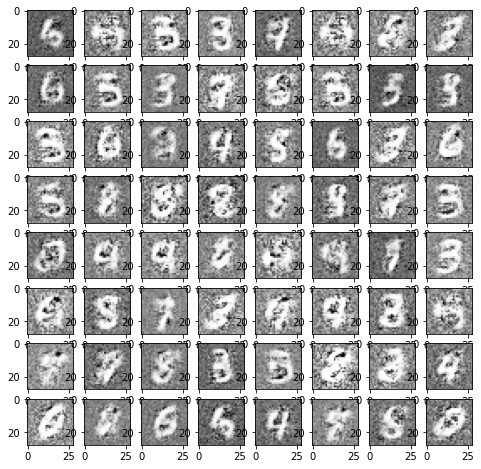

Epoch:  17
Discriminator Real Loss:  tensor(0.5801, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1861, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.5878, grad_fn=<BinaryCrossEntropyBackward0>)


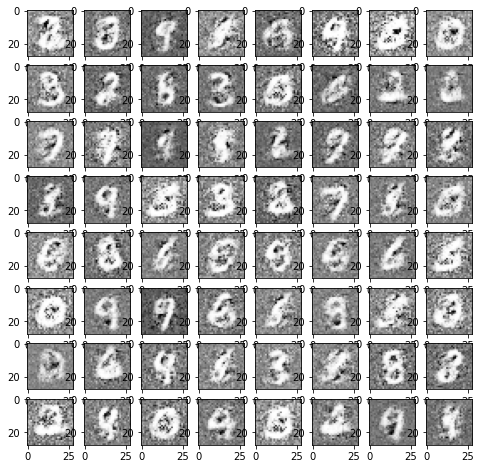

Epoch:  17
Discriminator Real Loss:  tensor(0.1443, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2864, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.9685, grad_fn=<BinaryCrossEntropyBackward0>)


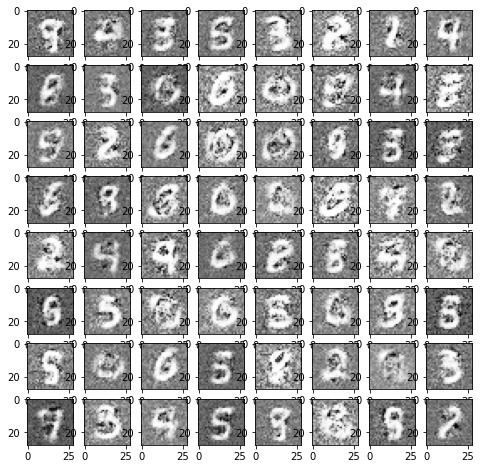

Epoch:  17
Discriminator Real Loss:  tensor(0.2398, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1811, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.8452, grad_fn=<BinaryCrossEntropyBackward0>)


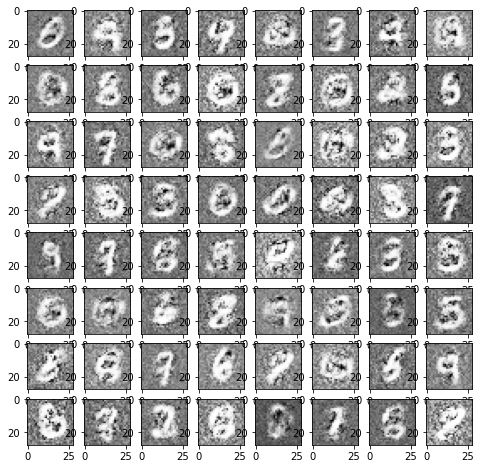

Epoch:  18
Discriminator Real Loss:  tensor(0.5747, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1256, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.1863, grad_fn=<BinaryCrossEntropyBackward0>)


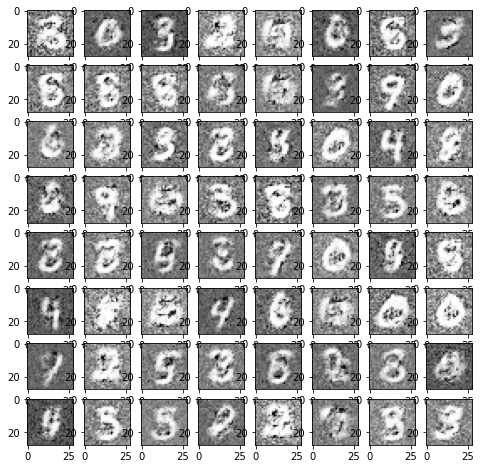

Epoch:  18
Discriminator Real Loss:  tensor(0.2645, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2160, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.9516, grad_fn=<BinaryCrossEntropyBackward0>)


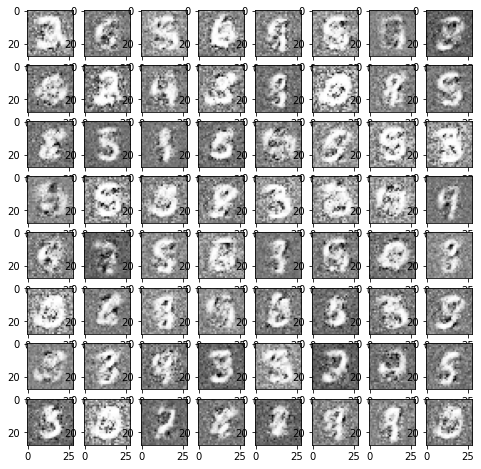

Epoch:  18
Discriminator Real Loss:  tensor(0.3016, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.0991, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.5837, grad_fn=<BinaryCrossEntropyBackward0>)


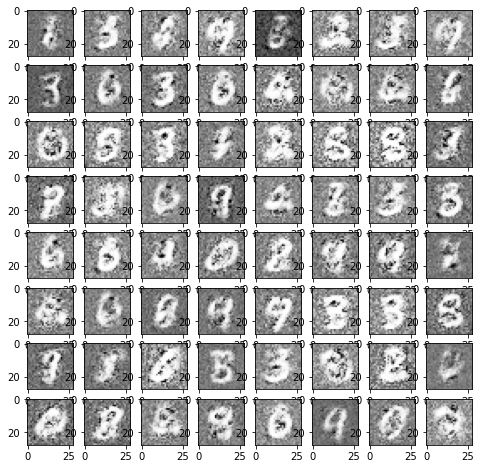

Epoch:  18
Discriminator Real Loss:  tensor(0.4997, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.0457, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.5301, grad_fn=<BinaryCrossEntropyBackward0>)


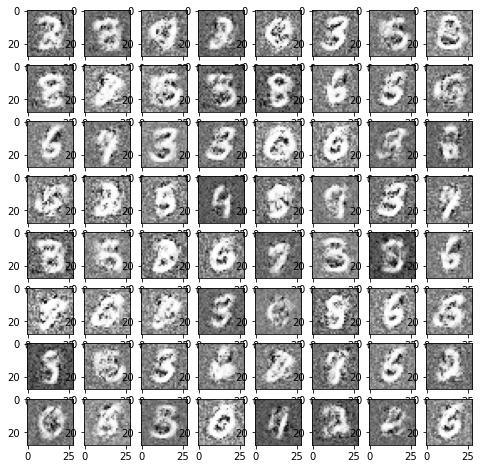

Epoch:  19
Discriminator Real Loss:  tensor(0.1607, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4084, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(4.0528, grad_fn=<BinaryCrossEntropyBackward0>)


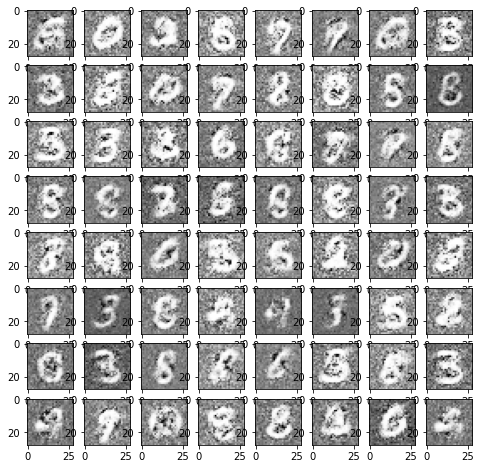

Epoch:  19
Discriminator Real Loss:  tensor(0.5242, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.0815, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.3613, grad_fn=<BinaryCrossEntropyBackward0>)


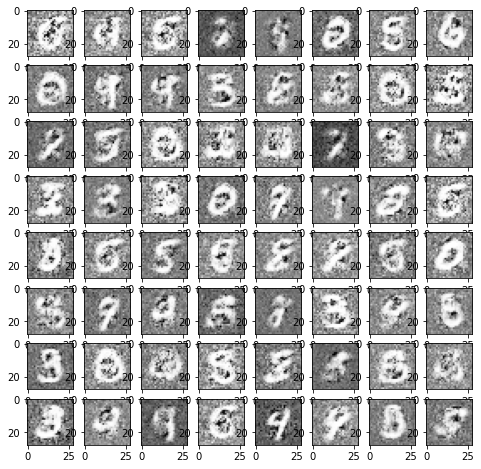

Epoch:  19
Discriminator Real Loss:  tensor(0.3096, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1894, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.7606, grad_fn=<BinaryCrossEntropyBackward0>)


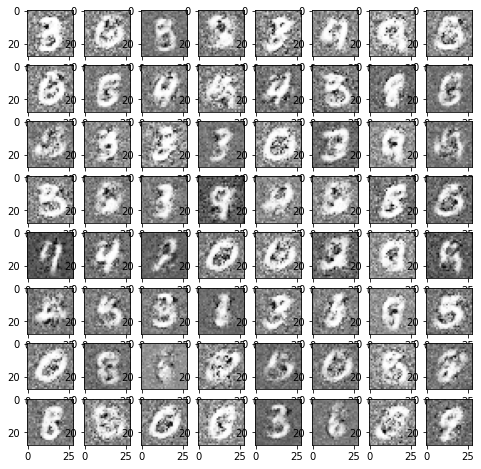

Epoch:  19
Discriminator Real Loss:  tensor(0.3715, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1276, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.6368, grad_fn=<BinaryCrossEntropyBackward0>)


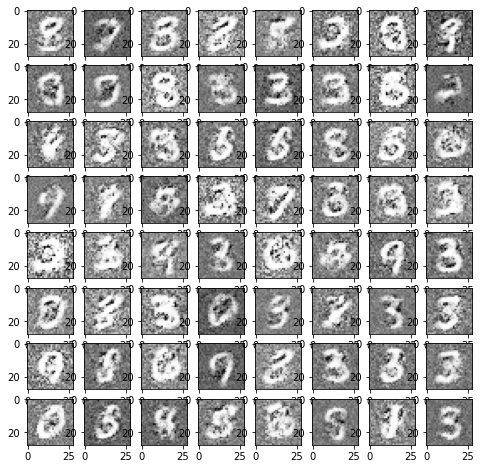

Epoch:  20
Discriminator Real Loss:  tensor(0.2372, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1907, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.2999, grad_fn=<BinaryCrossEntropyBackward0>)


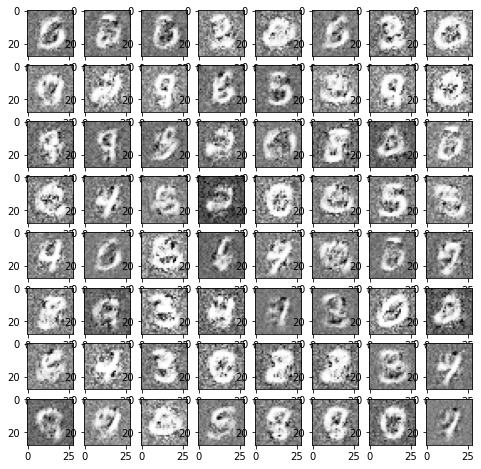

Epoch:  20
Discriminator Real Loss:  tensor(0.1406, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2622, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.5920, grad_fn=<BinaryCrossEntropyBackward0>)


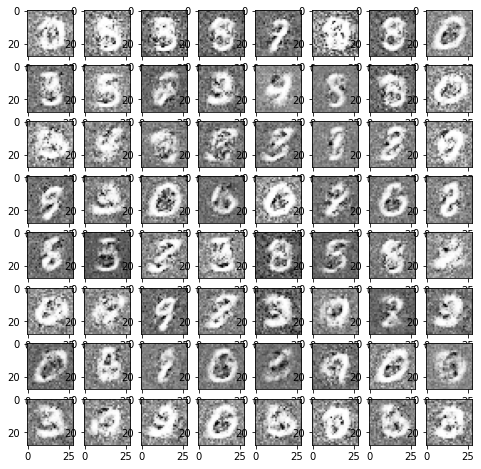

Epoch:  20
Discriminator Real Loss:  tensor(0.1090, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2391, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.9329, grad_fn=<BinaryCrossEntropyBackward0>)


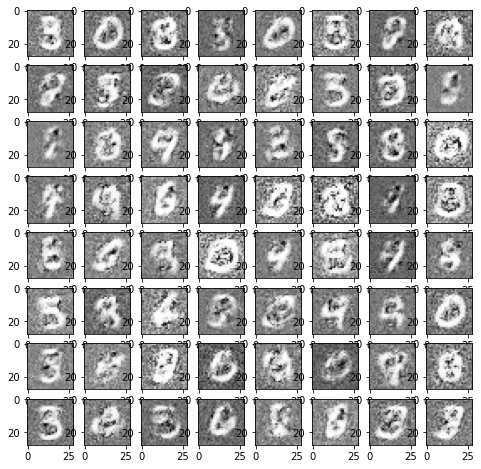

Epoch:  20
Discriminator Real Loss:  tensor(0.1061, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3029, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(4.1088, grad_fn=<BinaryCrossEntropyBackward0>)


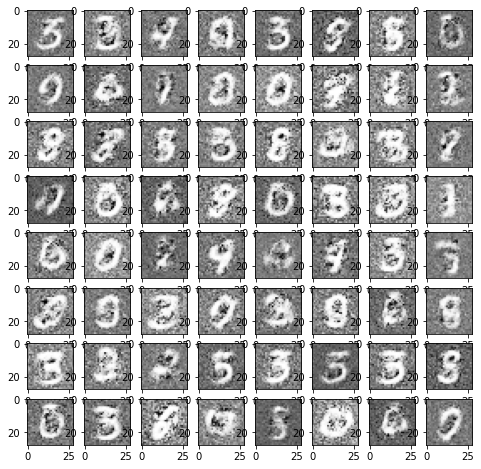

Epoch:  21
Discriminator Real Loss:  tensor(0.1707, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1695, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.2575, grad_fn=<BinaryCrossEntropyBackward0>)


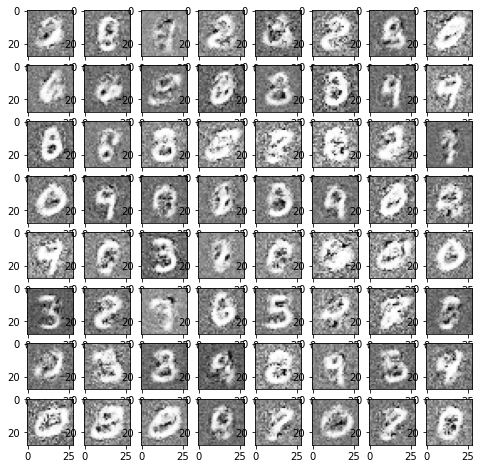

Epoch:  21
Discriminator Real Loss:  tensor(0.3555, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2961, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.4207, grad_fn=<BinaryCrossEntropyBackward0>)


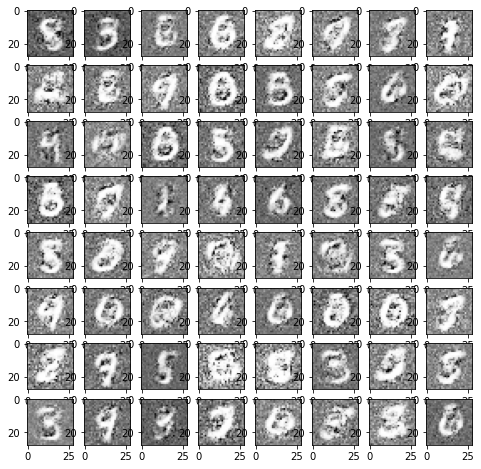

Epoch:  21
Discriminator Real Loss:  tensor(0.3391, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.0985, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.9128, grad_fn=<BinaryCrossEntropyBackward0>)


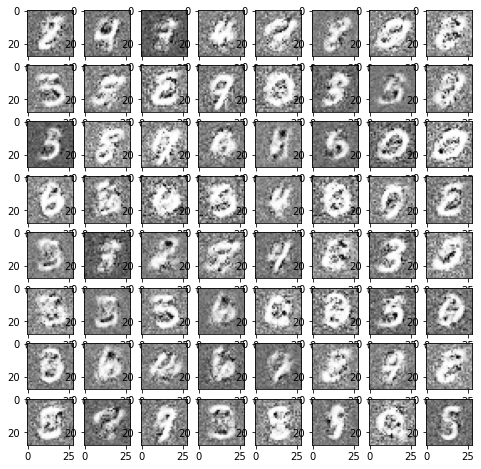

Epoch:  21
Discriminator Real Loss:  tensor(0.3969, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2045, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.0800, grad_fn=<BinaryCrossEntropyBackward0>)


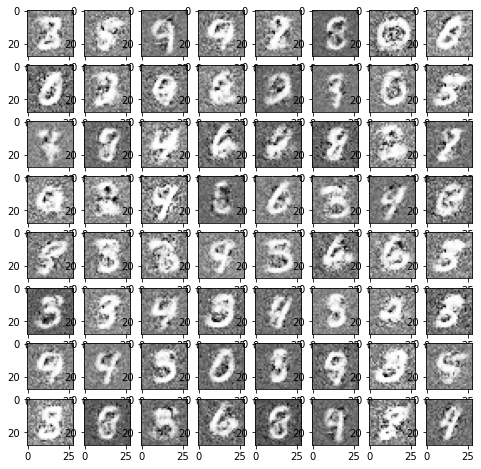

Epoch:  22
Discriminator Real Loss:  tensor(0.1048, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3498, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.8394, grad_fn=<BinaryCrossEntropyBackward0>)


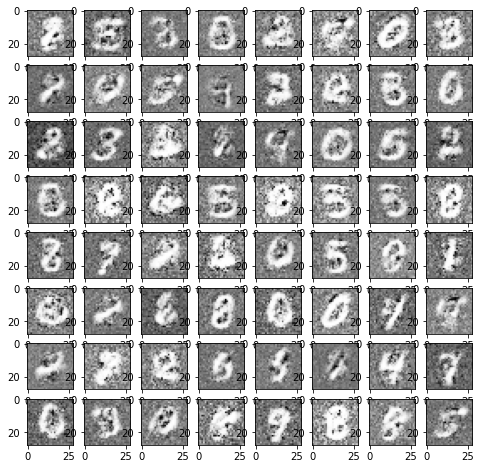

Epoch:  22
Discriminator Real Loss:  tensor(0.3167, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1661, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.1220, grad_fn=<BinaryCrossEntropyBackward0>)


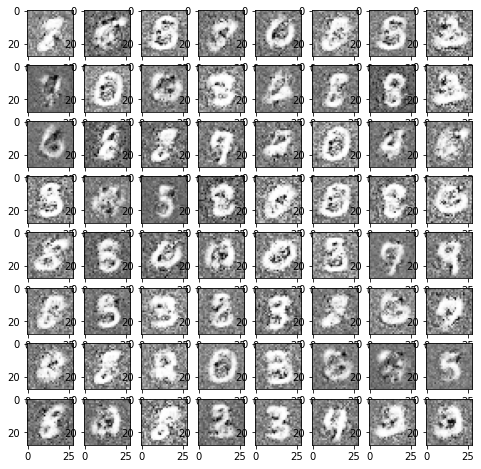

Epoch:  22
Discriminator Real Loss:  tensor(0.2882, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3818, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.3394, grad_fn=<BinaryCrossEntropyBackward0>)


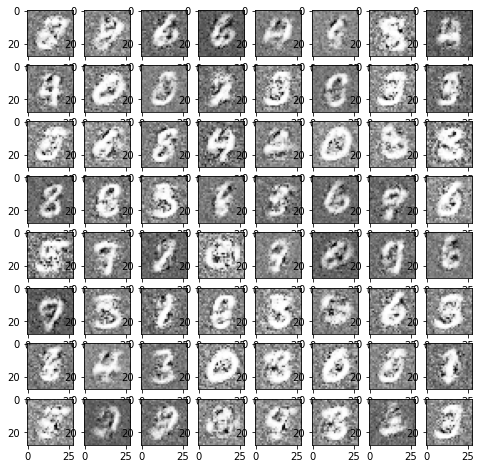

Epoch:  22
Discriminator Real Loss:  tensor(0.3935, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2646, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.9270, grad_fn=<BinaryCrossEntropyBackward0>)


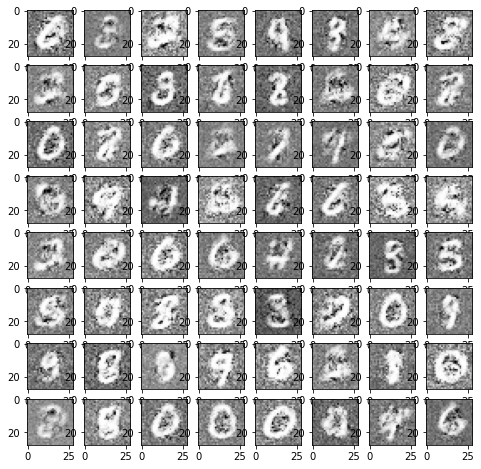

Epoch:  23
Discriminator Real Loss:  tensor(0.1479, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3357, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.5807, grad_fn=<BinaryCrossEntropyBackward0>)


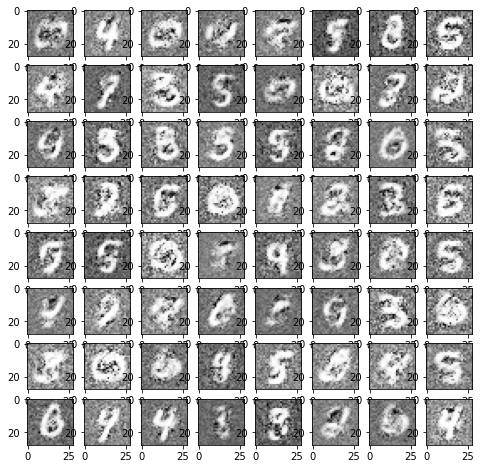

Epoch:  23
Discriminator Real Loss:  tensor(0.2418, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2477, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.6092, grad_fn=<BinaryCrossEntropyBackward0>)


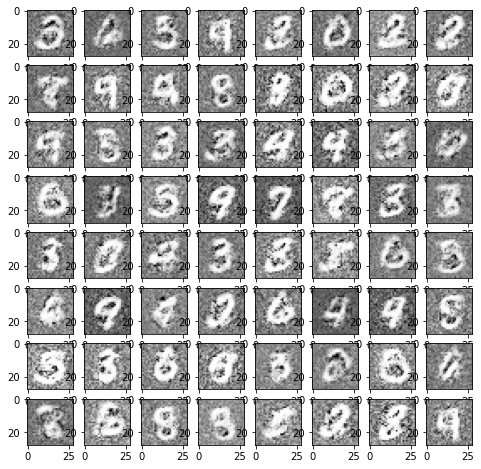

Epoch:  23
Discriminator Real Loss:  tensor(0.4176, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1502, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.1982, grad_fn=<BinaryCrossEntropyBackward0>)


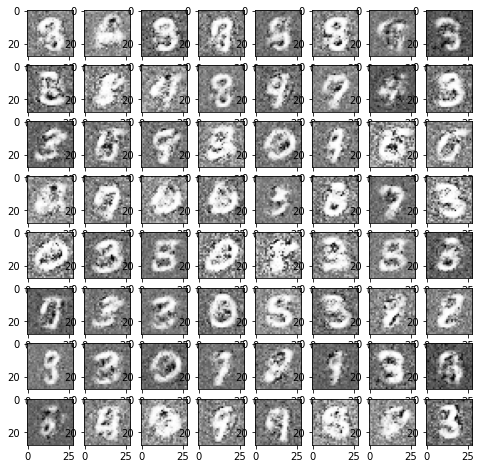

Epoch:  23
Discriminator Real Loss:  tensor(0.4860, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1545, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.7127, grad_fn=<BinaryCrossEntropyBackward0>)


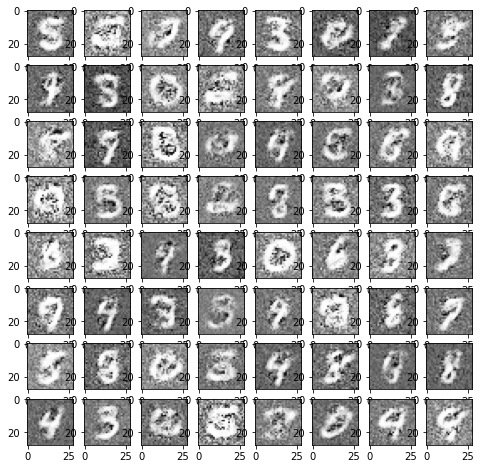

Epoch:  24
Discriminator Real Loss:  tensor(0.2918, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3558, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.9632, grad_fn=<BinaryCrossEntropyBackward0>)


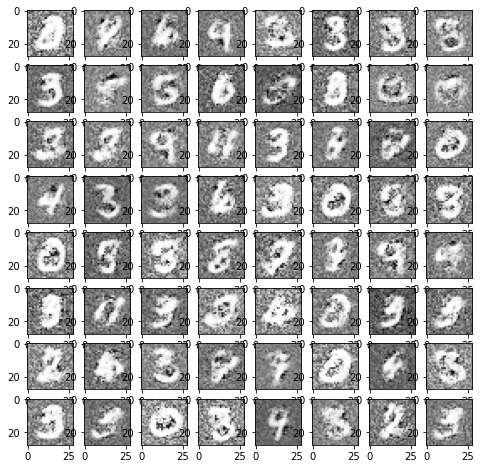

Epoch:  24
Discriminator Real Loss:  tensor(0.1583, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1823, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(4.0854, grad_fn=<BinaryCrossEntropyBackward0>)


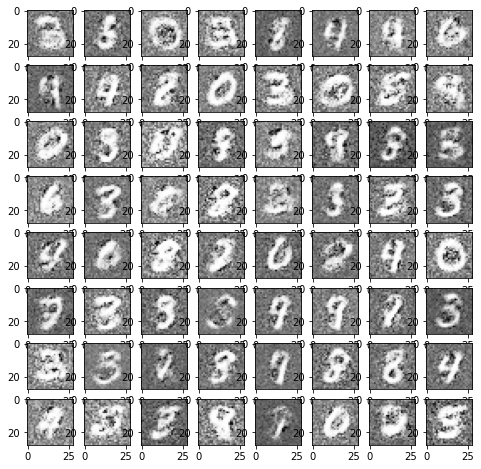

Epoch:  24
Discriminator Real Loss:  tensor(0.1004, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3123, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(4.0627, grad_fn=<BinaryCrossEntropyBackward0>)


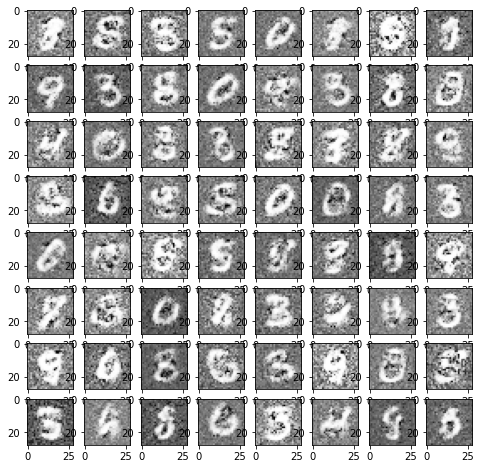

Epoch:  24
Discriminator Real Loss:  tensor(0.4414, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.0576, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.1331, grad_fn=<BinaryCrossEntropyBackward0>)


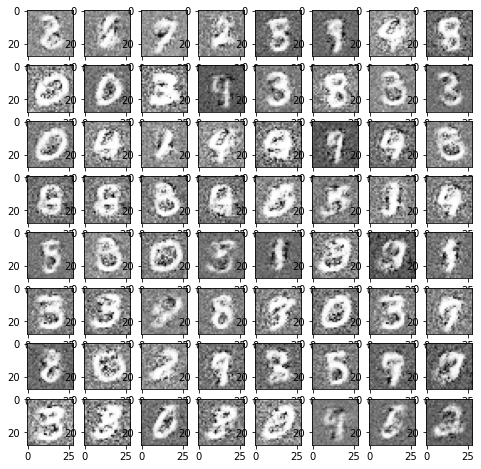

Epoch:  25
Discriminator Real Loss:  tensor(0.1537, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2065, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.8139, grad_fn=<BinaryCrossEntropyBackward0>)


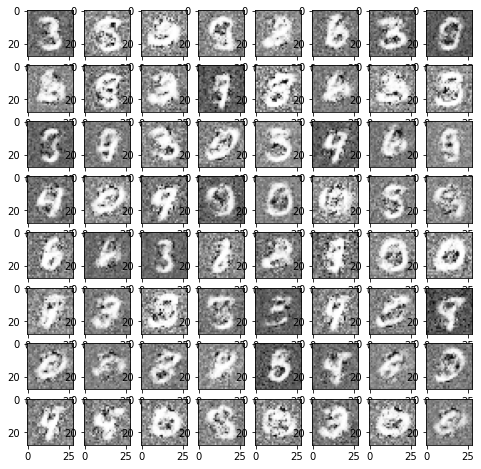

Epoch:  25
Discriminator Real Loss:  tensor(0.2700, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2955, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.3703, grad_fn=<BinaryCrossEntropyBackward0>)


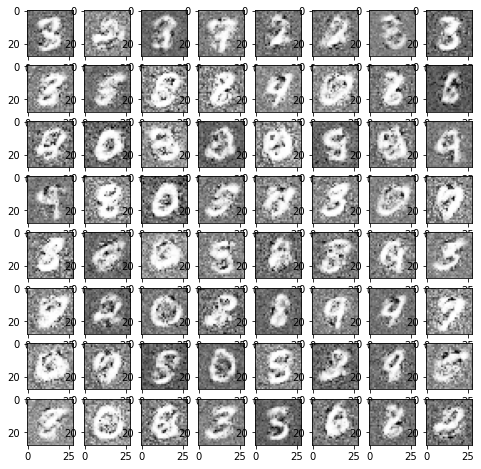

Epoch:  25
Discriminator Real Loss:  tensor(0.3861, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.0740, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.1105, grad_fn=<BinaryCrossEntropyBackward0>)


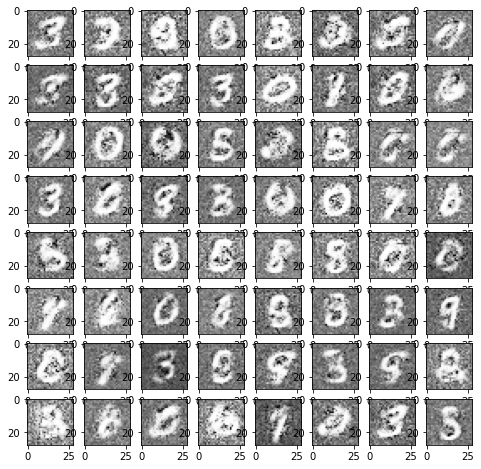

Epoch:  25
Discriminator Real Loss:  tensor(0.0904, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3107, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(4.1934, grad_fn=<BinaryCrossEntropyBackward0>)


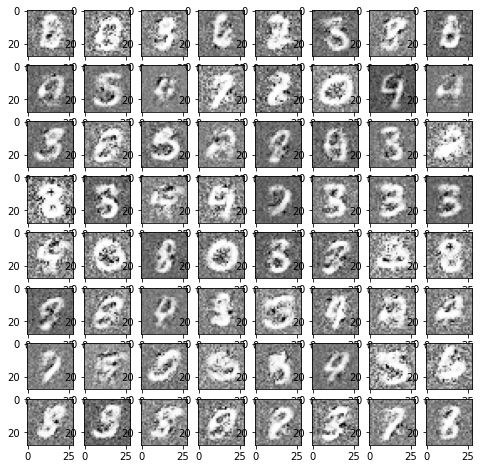

Epoch:  26
Discriminator Real Loss:  tensor(0.2591, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1176, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.9675, grad_fn=<BinaryCrossEntropyBackward0>)


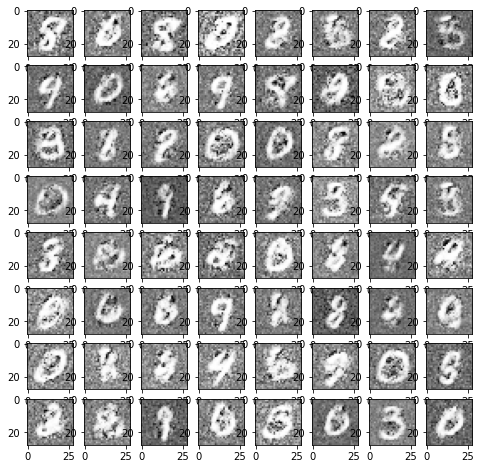

Epoch:  26
Discriminator Real Loss:  tensor(0.2605, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2673, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(4.4857, grad_fn=<BinaryCrossEntropyBackward0>)


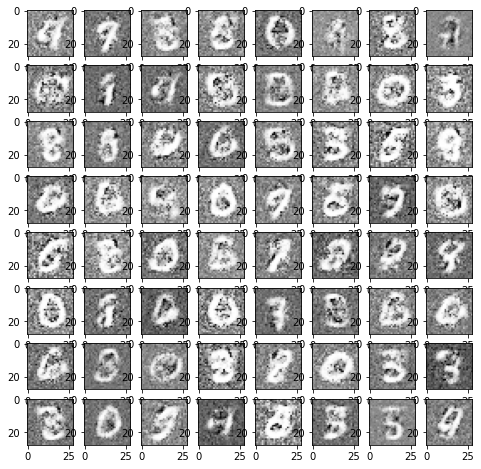

Epoch:  26
Discriminator Real Loss:  tensor(0.1625, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4710, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(4.8152, grad_fn=<BinaryCrossEntropyBackward0>)


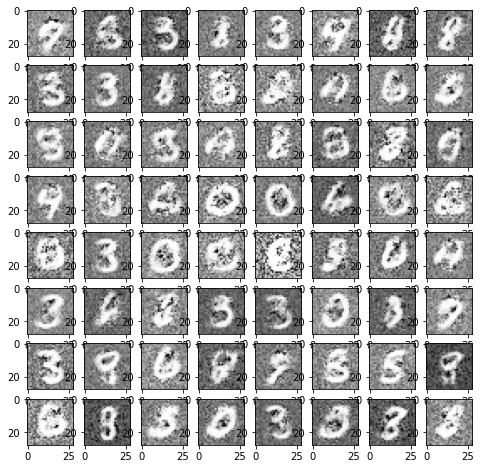

Epoch:  26
Discriminator Real Loss:  tensor(0.2164, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2332, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.8620, grad_fn=<BinaryCrossEntropyBackward0>)


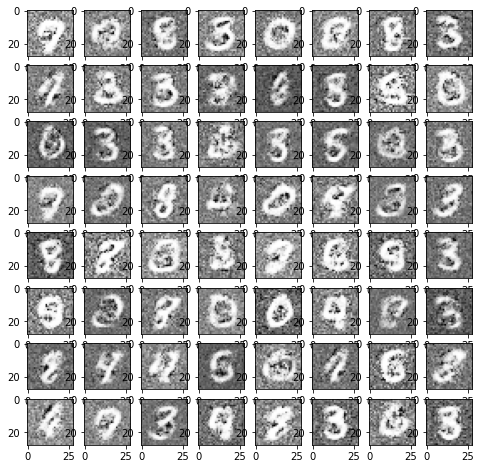

Epoch:  27
Discriminator Real Loss:  tensor(0.1295, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2445, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(4.6255, grad_fn=<BinaryCrossEntropyBackward0>)


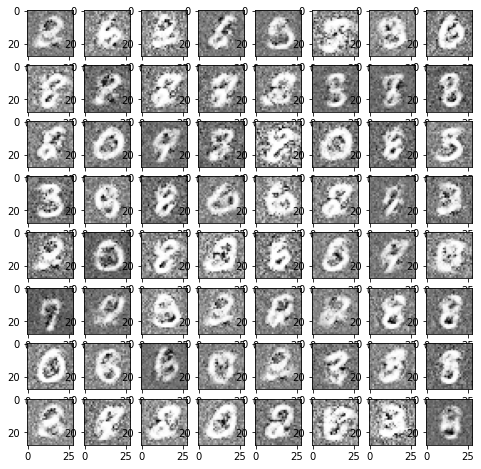

Epoch:  27
Discriminator Real Loss:  tensor(0.0378, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.5215, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(5.7587, grad_fn=<BinaryCrossEntropyBackward0>)


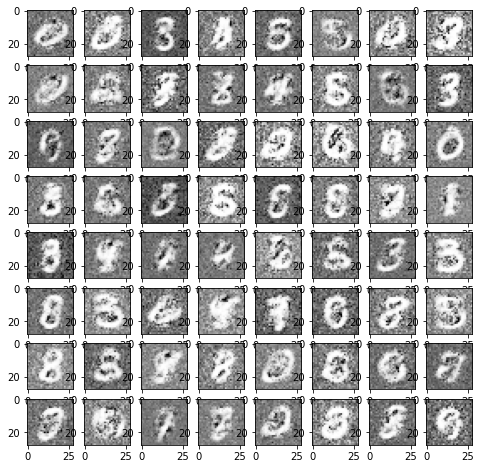

Epoch:  27
Discriminator Real Loss:  tensor(0.2447, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1112, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.9339, grad_fn=<BinaryCrossEntropyBackward0>)


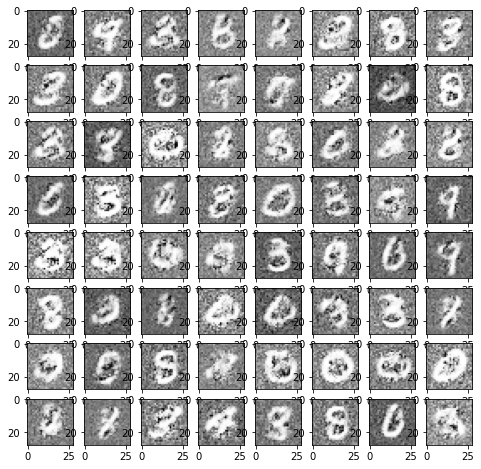

Epoch:  27
Discriminator Real Loss:  tensor(0.2177, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1469, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.4425, grad_fn=<BinaryCrossEntropyBackward0>)


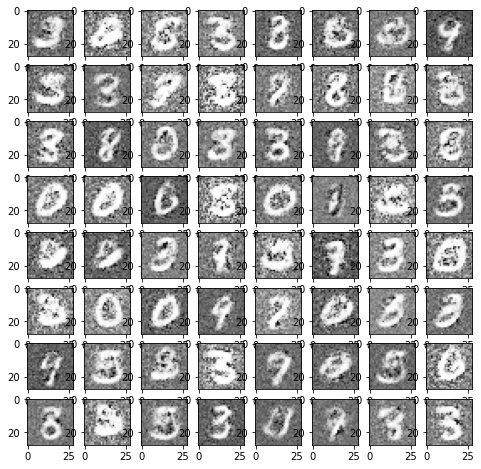

Epoch:  28
Discriminator Real Loss:  tensor(0.2409, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1119, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.1629, grad_fn=<BinaryCrossEntropyBackward0>)


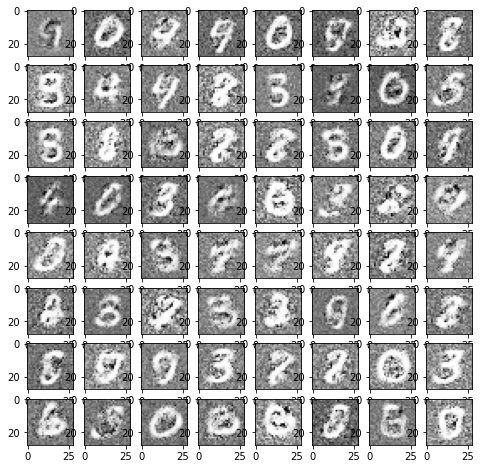

Epoch:  28
Discriminator Real Loss:  tensor(0.2359, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.0962, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.5864, grad_fn=<BinaryCrossEntropyBackward0>)


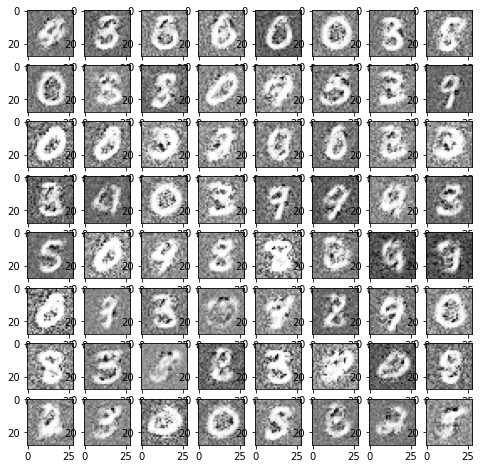

Epoch:  28
Discriminator Real Loss:  tensor(0.1893, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.0795, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(3.7349, grad_fn=<BinaryCrossEntropyBackward0>)


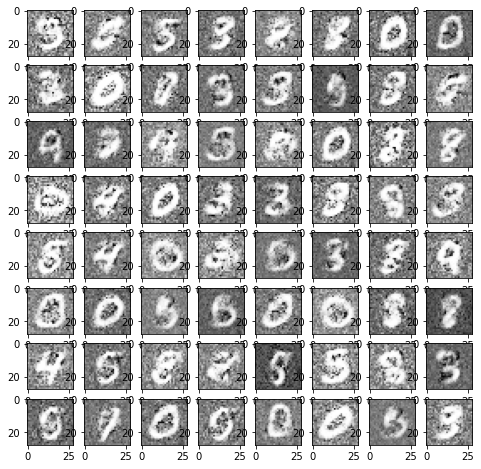

Epoch:  28
Discriminator Real Loss:  tensor(0.1034, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1512, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(4.0081, grad_fn=<BinaryCrossEntropyBackward0>)


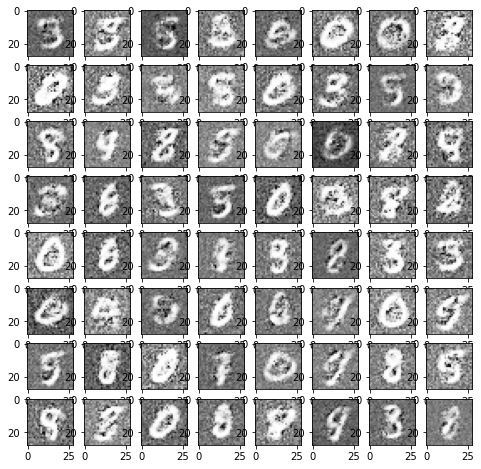

Epoch:  29
Discriminator Real Loss:  tensor(0.0565, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4721, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(5.2528, grad_fn=<BinaryCrossEntropyBackward0>)


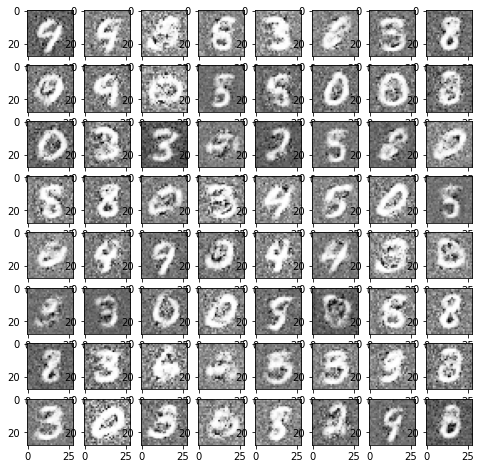

Epoch:  29
Discriminator Real Loss:  tensor(0.2124, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4213, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(4.8200, grad_fn=<BinaryCrossEntropyBackward0>)


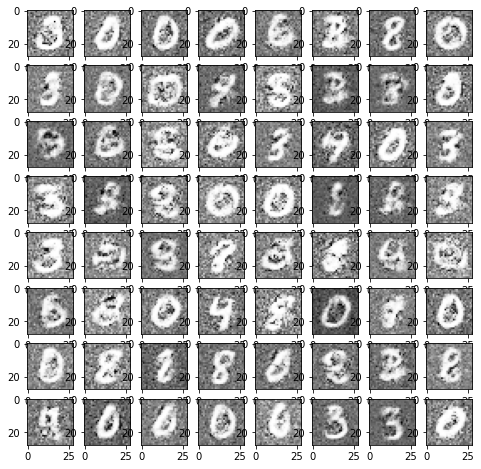

Epoch:  29
Discriminator Real Loss:  tensor(0.3246, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2318, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(4.2768, grad_fn=<BinaryCrossEntropyBackward0>)


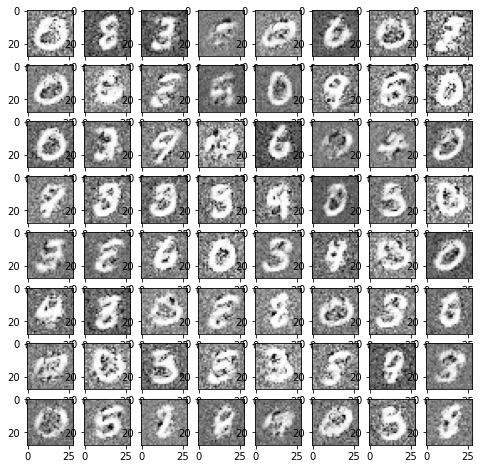

Epoch:  29
Discriminator Real Loss:  tensor(0.1133, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2793, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(4.3630, grad_fn=<BinaryCrossEntropyBackward0>)


In [18]:
def train_v1(train_loader, generator, discriminator, d_optim, g_optim, num_epochs=30):
    for epoch in range(num_epochs):
        cnt = 0
        for images, labels in train_loader:
            cnt += 1
            real_samples = torch.flatten(images, start_dim=1)
            # print(real_samples.shape)
            fake_samples = generate_fake_samples(generator)
            # display fake samples
            if cnt % 200 == 0:
                display_fake_samples(fake_samples.detach(), epoch, cnt)
            # calculate discriminator loss
            d_optim.zero_grad()
            # d_real_loss = torch.mean(torch.log(discriminator(real_samples)))
            d_real_loss = criterion(discriminator(real_samples), torch.ones(batch_size, 1))
            if cnt % 200 == 0:
                print("Epoch: ", epoch)
                print("Discriminator Real Loss: ", d_real_loss)
            # d_fake_loss = torch.mean(torch.log(1 - discriminator(fake_samples.detach())))
            d_fake_loss = criterion(discriminator(fake_samples.detach()), torch.zeros(batch_size, 1))
            if cnt % 200 == 0:
                print("Discriminator Fake Loss: ", d_fake_loss)

            # backprop gradients, update weights
            d_real_loss.backward()
            d_fake_loss.backward()
            d_optim.step()

            # calculate generator loss
            g_optim.zero_grad()
            # g_loss = -torch.mean(torch.log(1 - discriminator(fake_samples)))
            g_loss = criterion(discriminator(fake_samples), torch.ones(batch_size, 1))
            if cnt % 200 == 0:
                print("Generator Real Loss: ", g_loss)
            # backprop gradients, update weights
            g_loss.backward()
            g_optim.step()
    
train_v1(train_loader, generator, discriminator, d_optim, g_optim)

## FashionMNIST

Dataset FashionMNIST
    Number of datapoints: 60000
    Root location: ./dataset
    Split: Train
    StandardTransform
Transform: Compose(
               Resize(size=64, interpolation=bilinear, max_size=None, antialias=None)
               ToTensor()
               Normalize(mean=0.5, std=0.5)
           )
['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat', 'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']
torch.Size([64, 64])


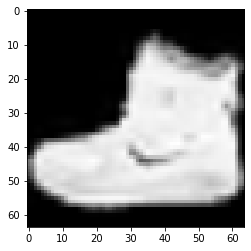

In [31]:
batch_size, image_size = 64, 64
fashion_mnist_train = download_data(image_size, 'FashionMNIST')
print(fashion_mnist_train)

print(fashion_mnist_train.classes)

# visualize first image
print(fashion_mnist_train[0][0][0].shape)
plt.imshow(fashion_mnist_train[0][0][0], cmap='Greys_r')

In [32]:
train_loader = torch.utils.data.DataLoader(
    fashion_mnist_train, batch_size=batch_size, drop_last=True, shuffle=True
)

for images, labels in train_loader:
    print(images.shape, labels.shape)
    break
    
# num minibatches 
print(len(train_loader))

torch.Size([64, 1, 64, 64]) torch.Size([64])
937


In [35]:
image_shape, hidden_dim = 64 * 64, 128

generator = Generator(image_shape, hidden_dim)
discriminator = Discriminator(image_shape, hidden_dim)

d_optim, g_optim = torch.optim.Adam(
    discriminator.parameters(), lr=2e-4, betas=(0.0, 0.9)
), torch.optim.Adam(
    generator.parameters(), lr=2e-4, betas=(0.0, 0.9)
)
criterion = torch.nn.BCELoss()

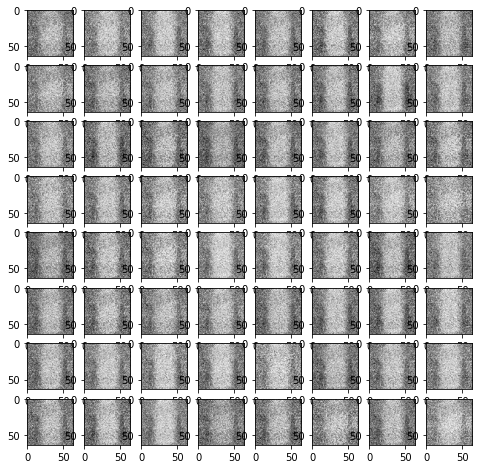

Epoch:  0
Discriminator Real Loss:  tensor(0.3508, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3250, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.6851, grad_fn=<BinaryCrossEntropyBackward0>)


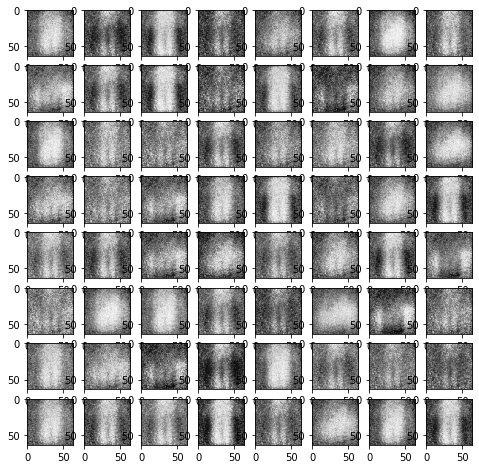

Epoch:  0
Discriminator Real Loss:  tensor(0.5837, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.2308, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(0.7359, grad_fn=<BinaryCrossEntropyBackward0>)


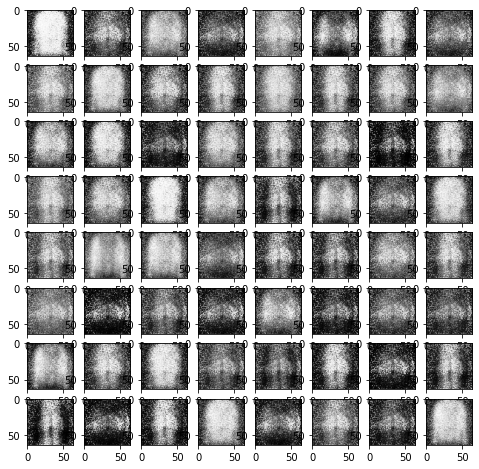

Epoch:  0
Discriminator Real Loss:  tensor(0.5239, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.1906, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.1613, grad_fn=<BinaryCrossEntropyBackward0>)


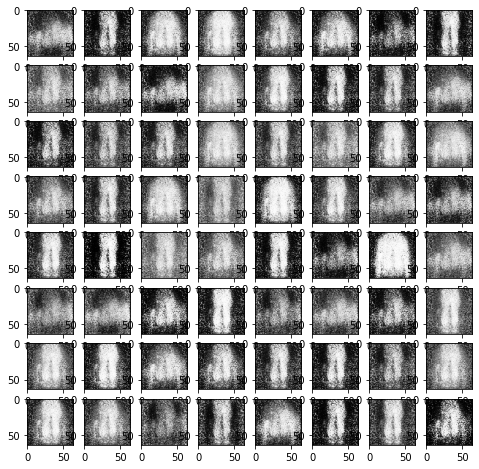

Epoch:  0
Discriminator Real Loss:  tensor(0.1533, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6002, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(2.5494, grad_fn=<BinaryCrossEntropyBackward0>)


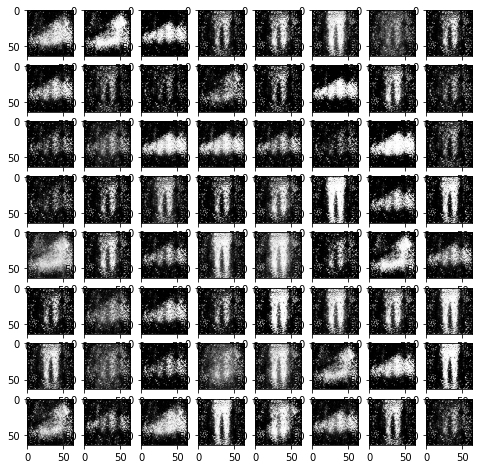

Epoch:  1
Discriminator Real Loss:  tensor(0.3215, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.5938, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.8727, grad_fn=<BinaryCrossEntropyBackward0>)


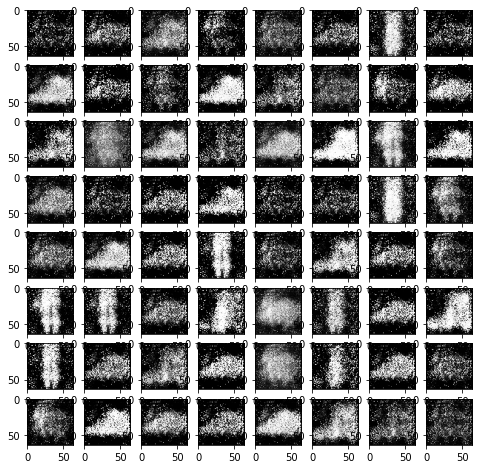

Epoch:  1
Discriminator Real Loss:  tensor(0.7016, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4007, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.2281, grad_fn=<BinaryCrossEntropyBackward0>)


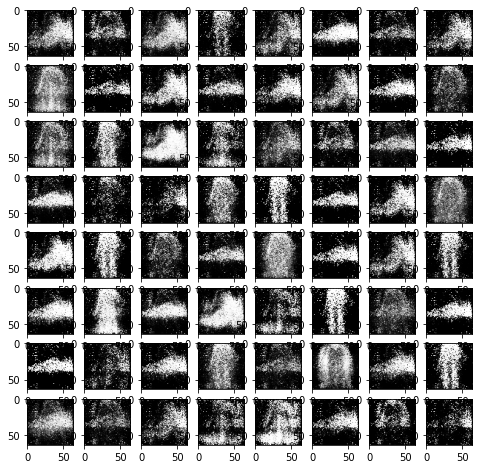

Epoch:  1
Discriminator Real Loss:  tensor(0.5492, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4127, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.7068, grad_fn=<BinaryCrossEntropyBackward0>)


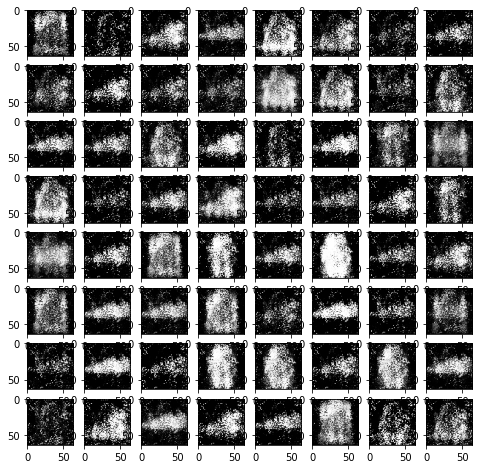

Epoch:  1
Discriminator Real Loss:  tensor(0.5222, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6718, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.8608, grad_fn=<BinaryCrossEntropyBackward0>)


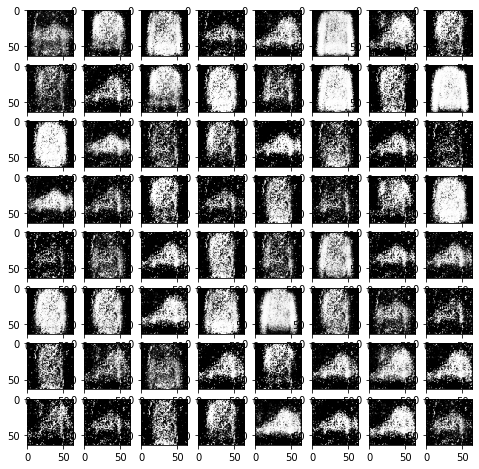

Epoch:  2
Discriminator Real Loss:  tensor(0.4057, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.6700, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.9306, grad_fn=<BinaryCrossEntropyBackward0>)


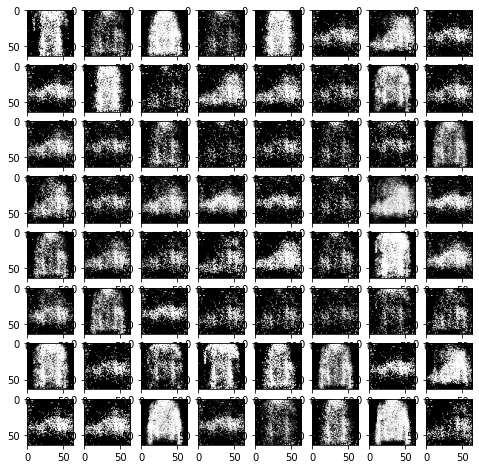

Epoch:  2
Discriminator Real Loss:  tensor(0.7124, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4591, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.1118, grad_fn=<BinaryCrossEntropyBackward0>)


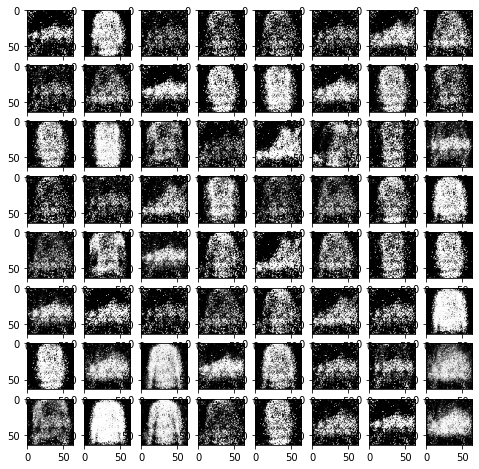

Epoch:  2
Discriminator Real Loss:  tensor(0.5708, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3997, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.5188, grad_fn=<BinaryCrossEntropyBackward0>)


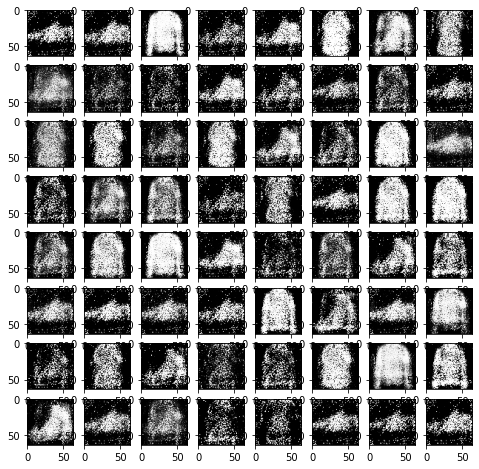

Epoch:  2
Discriminator Real Loss:  tensor(0.6810, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.3433, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.3900, grad_fn=<BinaryCrossEntropyBackward0>)


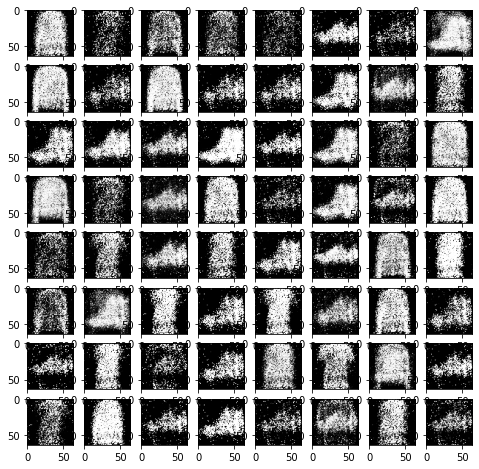

Epoch:  3
Discriminator Real Loss:  tensor(0.4766, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.4197, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.3059, grad_fn=<BinaryCrossEntropyBackward0>)


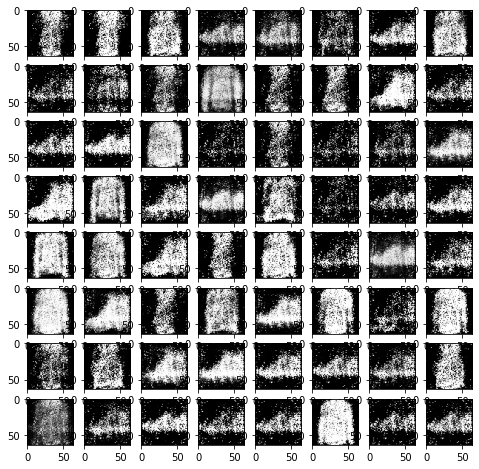

Epoch:  3
Discriminator Real Loss:  tensor(0.4933, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.5520, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.2510, grad_fn=<BinaryCrossEntropyBackward0>)


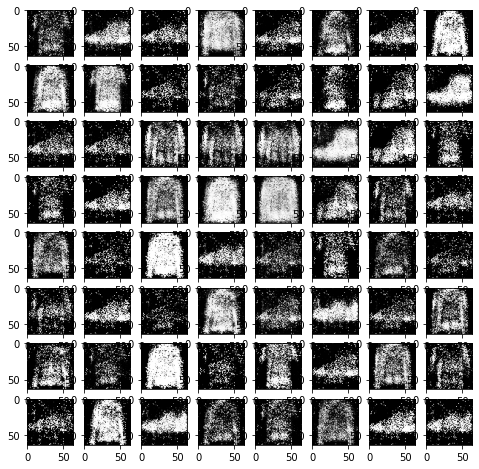

Epoch:  3
Discriminator Real Loss:  tensor(0.5080, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.7657, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.8109, grad_fn=<BinaryCrossEntropyBackward0>)


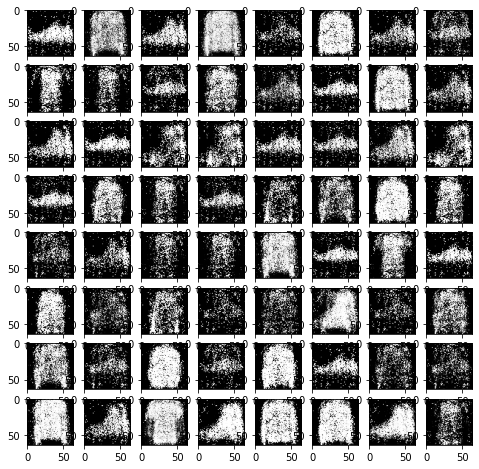

Epoch:  3
Discriminator Real Loss:  tensor(0.5081, grad_fn=<BinaryCrossEntropyBackward0>)
Discriminator Fake Loss:  tensor(0.8708, grad_fn=<BinaryCrossEntropyBackward0>)
Generator Real Loss:  tensor(1.4562, grad_fn=<BinaryCrossEntropyBackward0>)


KeyboardInterrupt: 

In [36]:
train_v1(train_loader, generator, discriminator, d_optim, g_optim, num_epochs=2)

## CelebA

In [37]:
dataroot='./dataset/processed_celeba_small'
transformations = torchvision.transforms.Compose([
      torchvision.transforms.Resize(image_size),
      torchvision.transforms.Grayscale(),
      torchvision.transforms.ToTensor(),
    ])

faces_dataset = torchvision.datasets.ImageFolder(
    root=dataroot,
    transform=transformations
)

celeb_train_loader = torch.utils.data.DataLoader(
    faces_dataset, batch_size=batch_size, drop_last=True, shuffle=True
)

torch.Size([64, 1, 64, 64]) torch.Size([64])
1405
torch.Size([64, 64])


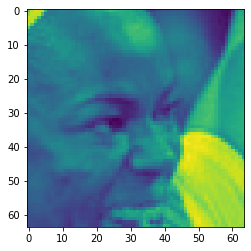

In [38]:
for images, labels in celeb_train_loader:
    print(images.shape, labels.shape)
    break
    
# num minibatches 
print(len(celeb_train_loader))

print(faces_dataset[0][0][0].shape)
plt.imshow(faces_dataset[0][0][0])

In [39]:
celeb_image_shape, hidden_dim = 64 * 64, 256

In [40]:
celeb_generator = Generator(celeb_image_shape, hidden_dim)
celeb_discriminator = Discriminator(celeb_image_shape, hidden_dim)

celeb_d_optim, celeb_g_optim = torch.optim.Adam(
    discriminator.parameters(), lr=0.001, betas=(0.0, 0.9)
), torch.optim.Adam(
    generator.parameters(), lr=0.001, betas=(0.0, 0.9)
)
celeb_criterion = torch.nn.BCELoss()

In [ ]:
train_v1(celeb_train_loader, celeb_generator, celeb_discriminator, celeb_d_optim, celeb_g_optim, num_epochs=10)